In [1]:
!pip3 install timm

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 549.1/549.1 kB 2.4 MB/s eta 0:00:00


In [2]:
!pip3 install tqdm

In [3]:
!pip3 install torch==1.12.1 torchvision==0.13.1 torchaudio==0.12.1

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 776.3/776.3 MB 1.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 19.1/19.1 MB 32.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.7/3.7 MB 42.6 MB/s eta 0:00:00
  Attempting uninstall: torch
    Found existing installation: torch 1.11.0
    Uninstalling torch-1.11.0:
      Successfully uninstalled torch-1.11.0
  Attempting uninstall: torchvision
    Found existing installation: torchvision 0.12.0
    Uninstalling torchvision-0.12.0:
      Successfully uninstalled torchvision-0.12.0
  Attempting uninstall: torchaudio
    Found existing installation: torchaudio 0.11.0
    Uninstalling torchaudio-0.11.0:
      Successfully uninstalled torchaudio-0.11.0


In [4]:
import time
import random
import torch
import argparse
import os
import torch.nn as nn
import scipy.stats as st
import matplotlib.pyplot as plt
import numpy as np
import torch.nn.functional as F
import torchvision.models as models
import torch.utils.data as data
import torchvision.transforms as transforms
import torchvision.models as models
from torch.nn.parameter import Parameter
from PIL import Image
from torch.autograd import Variable
from datetime import datetime
from tqdm.notebook import tqdm
from timm.models.layers import DropPath, to_2tuple, trunc_normal_
from functools import partial
from torchvision.models import resnet50, ResNet50_Weights
from typing import List

# **Backbone**

## **SegFormer https://arxiv.org/pdf/2105.15203.pdf**

In [5]:
class OverlapPatchEmbed(nn.Module):
    """ Image to Patch Embedding
    """
    def __init__(self, img_size=352, patch_size=7, stride=4, in_chans=3, embed_dim=768):
        super().__init__()
        self.proj = nn.Conv2d(in_chans, embed_dim, kernel_size=patch_size, stride=stride,
                              padding=patch_size // 2)
        self.norm = nn.LayerNorm(embed_dim)

    def forward(self, x):
        x = self.proj(x)
        _, _, H, W = x.shape 
        x = x.flatten(2).transpose(1, 2) # e.g from (1, 64, 88, 88) -> (1, 7744, 64)
        x = self.norm(x)
        return x, H, W
    
class DWConv(nn.Module):
    def __init__(self, dim=768):
        super(DWConv, self).__init__()
        # depth wise convolution
        self.dwconv = nn.Conv2d(in_channels=dim, out_channels=dim, kernel_size=3,
                                stride=1, padding=1, groups=dim,bias=True)

    def forward(self, x, H, W):
        B, N, C = x.shape
        x = x.transpose(1, 2).reshape(B, C, H, W)
        x = self.dwconv(x)
        x = x.flatten(2).transpose(1, 2)
        return x

class Mlp(nn.Module):
    def __init__(self, in_features, hidden_features=None, out_features=None, act_layer=nn.GELU, drop=0.):
        super().__init__()
        out_features = out_features or in_features
        self.hidden_features = hidden_features or in_features
        hidden_features = hidden_features or in_features
        self.fc1 = nn.Linear(in_features, hidden_features)
        self.dwconv = DWConv(hidden_features)
        self.act = act_layer()
        self.fc2 = nn.Linear(hidden_features, out_features)
        self.drop = nn.Dropout(drop)

    def forward(self, x, H, W):
        x = self.fc1(x)
        x = self.dwconv(x, H, W)
        x = self.act(x)
        x = self.drop(x)
        x = self.fc2(x)
        x = self.drop(x)
        return x

class Attention(nn.Module):
    def __init__(self, dim, num_heads=8, qkv_bias=False, qk_scale=None, attn_drop=0., proj_drop=0., sr_ratio=1):
        super().__init__()
        
        assert dim % num_heads == 0, f"dim {dim} should be divided by num_heads {num_heads}."
        self.dim = dim
        self.num_heads = num_heads
        head_dim = dim // num_heads
        self.scale = qk_scale or head_dim ** -0.5
        self.q = nn.Linear(dim, dim, bias=qkv_bias)
        self.kv = nn.Linear(dim, dim * 2, bias=qkv_bias)
        self.attn_drop = nn.Dropout(attn_drop)
        self.proj = nn.Linear(dim, dim)
        self.proj_drop = nn.Dropout(proj_drop)
        self.sr_ratio = sr_ratio
        
        if sr_ratio > 1:
            self.sr = nn.Conv2d(dim, dim, kernel_size=sr_ratio, stride=sr_ratio)
            self.norm = nn.LayerNorm(dim)

    def forward(self, x, H, W):
        B, N, C = x.shape # N=H*W
        q = self.q(x).reshape(B, N, self.num_heads, C // self.num_heads).permute(0, 2, 1, 3)
        
        if self.sr_ratio > 1:
            x_ = x.permute(0, 2, 1).reshape(B, C, H, W)
            x_ = self.sr(x_).reshape(B, C, -1).permute(0, 2, 1)
            x_ = self.norm(x_)
            kv = self.kv(x_).reshape(B, -1, 2, self.num_heads, C // self.num_heads).permute(2, 0, 3, 1, 4)
        else:
            kv = self.kv(x).reshape(B, -1, 2, self.num_heads, C // self.num_heads).permute(2, 0, 3, 1, 4)
        
        k, v = kv[0], kv[1]
        attn = (q @ k.transpose(2, 3)) * self.scale
        attn = attn.softmax(dim=-1)
        attn = self.attn_drop(attn)
        x = (attn @ v).transpose(1, 2).reshape(B, N, C)
        x = self.proj(x)
        x = self.proj_drop(x)
        
        return x

class Block(nn.Module):
    def __init__(self, dim, num_heads, mlp_ratio=4., qkv_bias=False, qk_scale=None, drop=0., attn_drop=0.,
                 drop_path=0., act_layer=nn.GELU, norm_layer=nn.LayerNorm, sr_ratio=1):
        super().__init__()
        self.norm1 = norm_layer(dim)
        self.attn = Attention(
            dim,
            num_heads=num_heads, qkv_bias=qkv_bias, qk_scale=qk_scale,
            attn_drop=attn_drop, proj_drop=drop, sr_ratio=sr_ratio)
        # NOTE: drop path for stochastic depth, we shall see if this is better than dropout here
        self.drop_path = DropPath(drop_path) if drop_path > 0. else nn.Identity()
        self.norm2 = norm_layer(dim)
        mlp_hidden_dim = int(dim * mlp_ratio)
        self.mlp = Mlp(in_features=dim, hidden_features=mlp_hidden_dim, act_layer=act_layer, drop=drop)

    def forward(self, x, H, W):
        x = x + self.drop_path(self.attn(self.norm1(x), H, W))
        x = x + self.drop_path(self.mlp(self.norm2(x), H, W))
        return x

class MixVisionTransformer(nn.Module):
    def __init__(self, img_size=224, in_chans=3, num_classes=1000, embed_dims=[64, 128, 256, 512],
                 num_heads=[1, 2, 4, 8], mlp_ratios=[4, 4, 4, 4], qkv_bias=False, qk_scale=None, drop_rate=0.,
                 attn_drop_rate=0., drop_path_rate=0., norm_layer=nn.LayerNorm,
                 depths=[3, 4, 6, 3], sr_ratios=[8, 4, 2, 1]):
        super().__init__()
        self.num_classes = num_classes
        self.depths = depths

        # patch_embed
        self.patch_embed1 = OverlapPatchEmbed(img_size=img_size, patch_size=7, stride=4, in_chans=in_chans,
                                              embed_dim=embed_dims[0])
        self.patch_embed2 = OverlapPatchEmbed(img_size=img_size // 4, patch_size=3, stride=2, in_chans=embed_dims[0],
                                              embed_dim=embed_dims[1])
        self.patch_embed3 = OverlapPatchEmbed(img_size=img_size // 8, patch_size=3, stride=2, in_chans=embed_dims[1],
                                              embed_dim=embed_dims[2])
        self.patch_embed4 = OverlapPatchEmbed(img_size=img_size // 16, patch_size=3, stride=2, in_chans=embed_dims[2],
                                              embed_dim=embed_dims[3])

        # transformer encoder
        dpr = [x.item() for x in torch.linspace(0, drop_path_rate, sum(depths))]  # stochastic depth decay rule
        cur = 0
        self.block1 = nn.ModuleList([Block(
            dim=embed_dims[0], num_heads=num_heads[0], mlp_ratio=mlp_ratios[0], qkv_bias=qkv_bias, qk_scale=qk_scale,
            drop=drop_rate, attn_drop=attn_drop_rate, drop_path=dpr[cur + i], norm_layer=norm_layer,
            sr_ratio=sr_ratios[0])
            for i in range(depths[0])])
        self.norm1 = norm_layer(embed_dims[0])

        cur += depths[0]
        self.block2 = nn.ModuleList([Block(
            dim=embed_dims[1], num_heads=num_heads[1], mlp_ratio=mlp_ratios[1], qkv_bias=qkv_bias, qk_scale=qk_scale,
            drop=drop_rate, attn_drop=attn_drop_rate, drop_path=dpr[cur + i], norm_layer=norm_layer,
            sr_ratio=sr_ratios[1])
            for i in range(depths[1])])
        self.norm2 = norm_layer(embed_dims[1])

        cur += depths[1]
        self.block3 = nn.ModuleList([Block(
            dim=embed_dims[2], num_heads=num_heads[2], mlp_ratio=mlp_ratios[2], qkv_bias=qkv_bias, qk_scale=qk_scale,
            drop=drop_rate, attn_drop=attn_drop_rate, drop_path=dpr[cur + i], norm_layer=norm_layer,
            sr_ratio=sr_ratios[2])
            for i in range(depths[2])])
        self.norm3 = norm_layer(embed_dims[2])

        cur += depths[2]
        self.block4 = nn.ModuleList([Block(
            dim=embed_dims[3], num_heads=num_heads[3], mlp_ratio=mlp_ratios[3], qkv_bias=qkv_bias, qk_scale=qk_scale,
            drop=drop_rate, attn_drop=attn_drop_rate, drop_path=dpr[cur + i], norm_layer=norm_layer,
            sr_ratio=sr_ratios[3])
            for i in range(depths[3])])
        self.norm4 = norm_layer(embed_dims[3])

        # classification head
        # self.head = nn.Linear(embed_dims[3], num_classes) if num_classes > 0 else nn.Identity()

    def forward_features(self, x):
        B = x.shape[0]
        outs = []
        # stage 1
        x, H, W = self.patch_embed1(x)
        for i, blk in enumerate(self.block1):
            x = blk(x, H, W)
        x = self.norm1(x)
        x = x.reshape(B, H, W, -1).permute(0, 3, 1, 2).contiguous()
        outs.append(x)
        # stage 2
        x, H, W = self.patch_embed2(x)
        for i, blk in enumerate(self.block2):
            x = blk(x, H, W)
        x = self.norm2(x)
        x = x.reshape(B, H, W, -1).permute(0, 3, 1, 2).contiguous()
        outs.append(x)
        # stage 3
        x, H, W = self.patch_embed3(x)
        for i, blk in enumerate(self.block3):
            x = blk(x, H, W)
        x = self.norm3(x)
        x = x.reshape(B, H, W, -1).permute(0, 3, 1, 2).contiguous()
        outs.append(x)
        # stage 4
        x, H, W = self.patch_embed4(x)
        for i, blk in enumerate(self.block4):
            x = blk(x, H, W)
        x = self.norm4(x)
        x = x.reshape(B, H, W, -1).permute(0, 3, 1, 2).contiguous()
        outs.append(x)
        return outs

    def forward(self, x):
        x = self.forward_features(x)
        # x = self.head(x)
        return x

## **ResNet50 Implementation**

In [6]:
class ResBlock50(nn.Module):
    def __init__(self, in_channels, out_channels, downsample):
        super().__init__()
        
        if in_channels != out_channels:
            self.conv1 = nn.Conv2d(in_channels, out_channels//4 if downsample else in_channels, kernel_size=1, stride=1, padding=0, bias=False)
            self.conv2 = nn.Conv2d(out_channels//4 if downsample else in_channels, out_channels//4 if downsample else in_channels, kernel_size=3, stride=2 if downsample else 1, padding=1, bias=False)
            self.conv3 = nn.Conv2d(out_channels//4 if downsample else in_channels, out_channels, kernel_size=1, stride=1, padding=0, bias=False)
            self.bn1 = nn.BatchNorm2d(out_channels//4 if downsample else in_channels)
            self.bn2 = nn.BatchNorm2d(out_channels//4 if downsample else in_channels)
            self.bn3 = nn.BatchNorm2d(out_channels)
            self.shortcut = nn.Sequential()
        else:
            self.conv1 = nn.Conv2d(in_channels, out_channels//4, kernel_size=1, stride=1, padding=0, bias=False)
            self.conv2 = nn.Conv2d(out_channels//4, out_channels//4, kernel_size=3, stride=2 if downsample else 1, padding=1, bias=False)
            self.conv3 = nn.Conv2d(out_channels//4, out_channels, kernel_size=1, stride=1, padding=0, bias=False)
            self.bn1 = nn.BatchNorm2d(out_channels//4)
            self.bn2 = nn.BatchNorm2d(out_channels//4)
            self.bn3 = nn.BatchNorm2d(out_channels)
            self.shortcut = nn.Sequential()
            
        if downsample or in_channels!= out_channels:
            self.shortcut = nn.Sequential(
                nn.Conv2d(in_channels, out_channels, kernel_size=1, stride=2 if downsample else 1, bias=False),
                nn.BatchNorm2d(out_channels)
            )
            
    def forward(self, input):
        shortcut = self.shortcut(input)
        input = nn.ReLU()(self.bn1(self.conv1(input)))
        #input = nn.ReLU()(self.bn2(self.conv2(input)))
        # An operation here refers to a convolution a batch normalization and a ReLU activation to an input, 
        # except the last operation of a block, that does not have the ReLU.
        # https://towardsdatascience.com/understanding-and-visualizing-resnets-442284831be8
        input = nn.ReLU()(self.bn2(self.conv2(input)))
        input = self.bn3(self.conv3(input))
        input = input + shortcut
        return nn.ReLU()(input)

class ResNet50(nn.Module):
    def __init__(self, in_channels, resblock50):
        super().__init__()
        self.layer0 = nn.Sequential(
            nn.Conv2d(in_channels, 64, kernel_size=7, stride=2, padding=3, bias=False),
            nn.MaxPool2d(kernel_size=3, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU()
        )

        self.layer1 = nn.Sequential(
            resblock50(64, 256, downsample=False),
            resblock50(256, 256, downsample=False),
            resblock50(256, 256, downsample=False),
        )

        self.layer2 = nn.Sequential(
            resblock50(256, 512, downsample=True),
            resblock50(512, 512, downsample=False),
            resblock50(512, 512, downsample=False),
            resblock50(512, 512, downsample=False),
        )

        self.layer3_1 = nn.Sequential(
            resblock50(512, 1024, downsample=True),
            resblock50(1024, 1024, downsample=False),
            resblock50(1024, 1024, downsample=False),
            resblock50(1024, 1024, downsample=False),
            resblock50(1024, 1024, downsample=False),
            resblock50(1024, 1024, downsample=False),
        )
        
        self.layer4_1 = nn.Sequential(
            resblock50(1024, 2048, downsample=True),
            resblock50(2048, 2048, downsample=False),
            resblock50(2048, 2048, downsample=False),
        )
        
    def forward(self, input):
        input = self.layer0(input)
        x_0 = input
        input = self.layer1(input)
        x_1 = input
        input = self.layer2(input)
        x_2 = input
        input = self.layer3_1(input)
        x_3 = input
        input = self.layer4_1(input)
        x_4 = input
        
        return x_0, x_1, x_2, x_3, x_4

## **RACOD-Net => Refined Accurate Camouflage Object Detection Network**

## **PRDM => Partial Refinement Decoder Module**

In [7]:
class ChannelAttention(nn.Module):
    def __init__(self, in_planes, ratio=16):
        super(ChannelAttention, self).__init__()
        self.avg_pool = nn.AdaptiveAvgPool2d(1)
        self.max_pool = nn.AdaptiveMaxPool2d(1)
        self.fc1   = nn.Conv2d(in_planes, in_planes // ratio, 1, bias=False)
        self.relu1 = nn.ReLU()
        self.fc2   = nn.Conv2d(in_planes // ratio, in_planes, 1, bias=False)
        self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        avg_out = self.fc2(self.relu1(self.fc1(self.avg_pool(x))))
        max_out = self.fc2(self.relu1(self.fc1(self.max_pool(x))))
        out = self.sigmoid(avg_out) + self.sigmoid(max_out)
        return out

class BasicConv2d(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size, stride=1, padding=0, dilation=1):
        super(BasicConv2d, self).__init__()
        self.conv = nn.Conv2d(in_channels, out_channels,
                              kernel_size=kernel_size, stride=stride,
                              padding=padding, dilation=dilation, bias=False)
        self.bn = nn.BatchNorm2d(out_channels)
        self.relu = nn.ReLU(inplace=True)

    def forward(self, x):
        x = self.conv(x)
        x = self.bn(x)
        return self.relu(x)

# New try 
class PRDM(nn.Module):
    def __init__(self, embed_dims, decoder_channels, num_classes):
        super(PRDM, self).__init__()
        assert min(embed_dims) == embed_dims[0]
        self.feature_strides = embed_dims
        self.num_classes = num_classes
        embedding_dim = decoder_channels
        self.conv_128 = BasicConv2d(128, embedding_dim, 1)
        self.conv_512 = BasicConv2d(512, embedding_dim, 1)
        self.conv_convert_64_384 = BasicConv2d(64, embedding_dim // 2, kernel_size=3, stride=1, padding=1,dilation=1)
        self.conv_convert_320_384 = BasicConv2d(320, embedding_dim // 2, kernel_size=3, stride=1, padding=1,dilation=1)
        self.conv_convert_320_512 = BasicConv2d(320, 512, kernel_size=3, stride=1, padding=1,dilation=1)
        self.conv_convert_1024_768 = BasicConv2d(1024, embedding_dim, kernel_size=3, stride=1, padding=1,dilation=1)
        
        self.conv_same = BasicConv2d(in_channels=embedding_dim, out_channels=embedding_dim, 
                                     kernel_size=3, stride=1, padding=1,dilation=1)
        
        self.conv_restore_double = BasicConv2d(in_channels=2*embedding_dim, out_channels=embedding_dim, 
                                       kernel_size=3, stride=1, padding=1, dilation=1)
        
        self.conv_double_same = BasicConv2d(in_channels=2*embedding_dim, out_channels=2*embedding_dim, 
                                       kernel_size=3, stride=1, padding=1, dilation=1)
        
        self.channelattn = ChannelAttention(embedding_dim)
        #self.relu = nn.ReLU(inplace=True)
        self.linear_pred_top = nn.Conv2d(embedding_dim, self.num_classes, kernel_size=1, stride=1, padding=0, dilation=1)
        self.linear_pred_final = nn.Conv2d(embedding_dim, self.num_classes, kernel_size=3, stride=1, padding=1, dilation=1)

    def forward(self, features, x0, x1, x2):
        c1, c2, c3, c4 = features[0], features[1], features[2], features[3]
        
        ############## Fusing C3 With X2 #############
        conv_c3 = self.conv_convert_320_512(F.interpolate(c3, size=x2.size()[2:], mode='bilinear', align_corners=False))        
        _c3_x2 = conv_c3 * x2 # (BS, 512, 51, 51)
        mixed_features = self.conv_convert_1024_768(torch.cat((_c3_x2, x2), dim=1)) # (BS, 768, 51, 51)

        ############## Decoder on C2-C4 ##############
        _c2 = self.conv_128(c2) # from (BS, 128, 51, 51) => (BS, 768, 51, 51)
        _c3 = self.conv_same(F.interpolate(mixed_features, size=c3.size()[2:], mode='bilinear', align_corners=False)) # (BS, 768, 26, 26)
        _c4 = self.conv_512(c4) # from (BS, 512, 13, 13) => (BS, 768, 13, 13)
        _c4_upsample2 = self.conv_same(F.interpolate(_c4, size=c3.size()[2:], mode='bilinear', align_corners=False)) # (BS, 768, 26, 26)
        
        _c4_c3 = self.conv_double_same(torch.cat((_c4_upsample2 * _c3, _c4_upsample2), dim=1)) # (BS, 1536, 26, 26)
        _c4_c3 = self.conv_restore_double(F.interpolate(_c4_c3, size=c2.size()[2:], mode='bilinear', align_corners=False)) # (768, 51, 51)
        _c4_upsample4 = self.conv_same(F.interpolate(_c4, size=c2.size()[2:], mode='bilinear', align_corners=False)) # (768, 51, 51)
        _c4_c3_c2 = _c4_upsample4 * _c2 * _c4_c3 # (768, 51, 51)
        
        top_features = self.conv_restore_double((torch.cat((_c4_c3_c2,  mixed_features), dim=1))) # (768, 51, 51)
        final_output_top = F.interpolate(self.linear_pred_top(top_features), scale_factor=8, mode='bilinear', align_corners=False) # (1, 1, 408, 408)
        
        ############## Decoder on C1-X0-X1 ##############
        x01 = self.conv_convert_320_384(torch.cat((x0, x1), dim=1))       # (BS, 384, 102, 102)
        #_c1_x0 = self.conv_convert_64_384(c1 * x0)                        # (BS, 384, 102, 102)
        final_bottom = self.conv_same(torch.cat((self.conv_convert_64_384(c1 * x0) * x01 , x01), dim=1)) # (BS, 768, 102, 102)
        final_bottom = self.conv_same(F.interpolate(final_bottom, size=c2.size()[2:], mode='bilinear', align_corners=False))# (BS, 768, 51, 51)
        final_bottom = self.conv_restore_double(torch.cat((mixed_features * final_bottom, mixed_features), dim=1)) # (BS, 768, 51, 51)

        ############## Channel Attention Between Top and Bottom  Features ##############
        add_features = top_features + final_bottom # (BS, 768, 51, 51)
        final_output = self.channelattn(add_features) * add_features # (BS, 768, 51, 51)
        mixed_features = self.conv_restore_double(torch.cat((_c4_c3, final_bottom), dim=1))  # (BS, 768, 51, 51)
        final_output = self.channelattn(mixed_features) * final_output # (BS, 768, 51, 51)
        final_output = F.interpolate(self.linear_pred_final(final_output), scale_factor=8, mode='bilinear', align_corners=False) # (1, 1, 408, 408)
        
        return final_output_top, final_output

In [8]:
class RACOD(nn.Module):
    def __init__(self, img_size: int, embed_dims: List[int], num_heads: List[int], mlp_ratios: List[int], 
                 qkv_bias: bool, depths: List[int], sr_ratios: List[int], drop_rate: float, drop_path_rate: float,
                 decoder_channels: int, num_classes: int, norm_layer=nn.LayerNorm):
        super().__init__()
        self.MixVisionTransformerEncoder = MixVisionTransformer(img_size=img_size, embed_dims=embed_dims, 
                                                                num_heads=num_heads, mlp_ratios=mlp_ratios, qkv_bias=qkv_bias, 
                                                                norm_layer=norm_layer, depths=depths, sr_ratios=sr_ratios, 
                                                                drop_rate=drop_rate, drop_path_rate=drop_path_rate)
        self.resnet = ResNet50(3, ResBlock50)
        self.PRDM = PRDM(embed_dims=embed_dims, decoder_channels=decoder_channels, num_classes=num_classes)
        
        if self.training:
            print("*** Initializing Weights For ResNet50 Encoder ***")
            self.initialize_weights_resnet()      
            print("*** Initializing Weights For VisionTransformerEncoder ***")
            self.initialize_weights_vit()      
            
    def forward(self, x):
        x0 = self.resnet.layer0(x)              # (64, 102, 102)
        x1 = self.resnet.layer1(x0)             # (256, 102, 102)
        x2 = self.resnet.layer2(x1)             # (512, 51, 51)
        features = self.MixVisionTransformerEncoder(x)  # 4 feautures produced here from SegFormer
        segmentation = self.PRDM(features, x0, x1, x2)  # Returns 2 predictions both in size (1, 1, 408, 408)
        return segmentation
    
    def initialize_weights_resnet(self):
        weights = ResNet50_Weights.DEFAULT
        resnet50_pretrained = resnet50(weights=weights)
        pretrained_dict = resnet50_pretrained.state_dict()
        all_params = {}
        # we use this dictionary because of our ResNet50 implementation of layer0
        replace_dict = {
            'layer0.0.weight':'conv1.weight', 
            'layer0.2.weight': 'bn1.weight', 
            'layer0.2.bias' : 'bn1.bias', 
            'layer0.2.running_mean' : 'bn1.running_mean',
            'layer0.2.running_var' : 'bn1.running_var',
            'layer0.2.num_batches_tracked' : 'bn1.num_batches_tracked'
           }
        
        for k, v in self.resnet.state_dict().items():
            if k in pretrained_dict.keys():
                v = pretrained_dict[k]
                all_params[k] = v
            elif '_1' in k and 'shortcut' not in k:
                name = k.split('_1')[0] + k.split('_1')[1]
                if name in pretrained_dict:
                    v = pretrained_dict[name]
                    all_params[k] = v
                else:
                    all_params[k] = v
            elif '_2' in k and 'shortcut' not in k:
                name = k.split('_2')[0] + k.split('_2')[1]
                if name in pretrained_dict:
                    v = pretrained_dict[name]
                    all_params[k] = v
                else:
                    all_params[k] = v
            # we use the below statement because of the word 'shortcut' instead of word 'downsample'
            # in our ResNet50 implementation
            elif 'shortcut' in k:
                name = k.split('shortcut')[0] + 'downsample' + k.split('shortcut')[1]
                if name in pretrained_dict:
                    v = pretrained_dict[name]
                    all_params[k] = v
                else:
                    if '_1' in name:
                        new_name = name.replace('_1', '')
                        v = pretrained_dict[new_name]
                        all_params[k] = v
                    elif '_2' in name:
                        new_name = name.replace('_2', '')
                        v = pretrained_dict[new_name]
                        all_params[k] = v
            elif k in replace_dict:
                name = replace_dict[k]
                v = pretrained_dict[name]
                all_params[k] = v

        assert len(all_params.keys()) == len(self.resnet.state_dict().keys())
        self.resnet.load_state_dict(all_params)
        print('[INFO] Weights Initialized For Resnet50 From torchvision.models Trained In IMAGENET1K_V2')
    
    def initialize_weights_vit(self):
        PATH_TO_PRETRAINED_WEIGHTS = '../input/mitb4-pretrainedweights/mit_b4.pth'
        CheckPoint = torch.load(PATH_TO_PRETRAINED_WEIGHTS)
        
        parameters_altered = 0
        all_params = {}
        for k_model, v_model in self.MixVisionTransformerEncoder.state_dict().items():
            if k_model in CheckPoint.keys():
                all_params[k_model] = CheckPoint[k_model]
                parameters_altered += 1
            else:
                all_params[k_model] = v_model
        
        assert len(all_params.keys()) == len(self.MixVisionTransformerEncoder.state_dict().keys())
        self.MixVisionTransformerEncoder.load_state_dict(all_params)
        print('[INFO] Weights Initialized For MixVisionTransformerEncoder From mit_b4 Weights Trained In ImageNet-1K')

In [9]:
%%time

# testing the output shape
TEST = True
TEST = False

if TEST:
    model = RACOD(
        img_size=408,
        embed_dims=[64, 128, 320, 512],
        num_heads=[1, 2, 5, 8],
        mlp_ratios=[4, 4, 4, 4],
        qkv_bias=True,
        norm_layer=partial(nn.LayerNorm, eps=1e-6),
        depths=[3, 8, 27, 3],
        sr_ratios=[8, 4, 2, 1],
        drop_rate=0.0,
        drop_path_rate=0.1,
        decoder_channels=768,
        num_classes=1
    )

    x = torch.randn(1, 3 , 408, 408)
    print(f'\nOutput has shape: {model(x)[0].shape, model(x)[1].shape}')

CPU times: user 7 µs, sys: 0 ns, total: 7 µs
Wall time: 14.3 µs


## **Importing The Datasets**

### **Our Train Dataset contains 1000 Images from CAMO Dataset & 3040 Images from COD10K Dataset**
### **Our Test Dataset contains 250 Images(CAMO) + 2026 Images(COD10K) + 76 Images(CHAMELEON) + 4121 Images(NC4K)**

In [10]:
# Train Dataset contains 1000 Images from CAMO Dataset & 2026 Images from COD10K Dataset
PATH_TO_IMAGES_TRAIN = '../input/train-dataset-cod/TrainDataset/Imgs'
PATH_TO_IMAGES_TRAIN_GT_Object = '../input/train-dataset-cod/TrainDataset/GT'

# Image Paths For Test From COD10K Dataset
PATH_TO_IMAGES_TEST_COD10K = '../input/test-dataset-cod/TestDataset/COD10K/Imgs'
PATH_TO_IMAGES_TEST_COD10K_GT_Object = '../input/test-dataset-cod/TestDataset/COD10K/GT'

# Image Paths For Test From Camo Dataset
PATH_TO_IMAGES_TEST_CAMO_DATASET = '../input/test-dataset-cod/TestDataset/CAMO/Imgs'
PATH_TO_IMAGES_TEST_CAMO_DATASET_GT_Object = '../input/test-dataset-cod/TestDataset/CAMO/GT'

# Image Paths For Test From Chameleon Dataset
PATH_TO_IMAGES_TEST_CHAMELEON_DATASET = '../input/test-dataset-cod/TestDataset/CHAMELEON/Imgs'
PATH_TO_IMAGES_TEST_CHAMELEON_DATASET_GT_Object = '../input/test-dataset-cod/TestDataset/CHAMELEON/GT'

# Image Paths For Test From NC4K Dataset
PATH_TO_IMAGES_TEST_NC4K_DATASET = '../input/test-dataset-cod/TestDataset/NC4K/Imgs'
PATH_TO_IMAGES_TEST_NC4K_DATASET_GT_Object = '../input/test-dataset-cod/TestDataset/NC4K/GT'

In [11]:
# define train variables from Train Dataset
train_images_half_path = sorted(os.listdir(PATH_TO_IMAGES_TRAIN))
train_images_half_path_gt_object = sorted(os.listdir(PATH_TO_IMAGES_TRAIN_GT_Object))

# define test variables from COD10K Dataset
test_images_cod10k_half_path = sorted(os.listdir(PATH_TO_IMAGES_TEST_COD10K))
test_images_cod10k_half_path_gt_object = sorted(os.listdir(PATH_TO_IMAGES_TEST_COD10K_GT_Object))

# define test variables from CAMO Dataset
test_images_camo_half_path = sorted(os.listdir(PATH_TO_IMAGES_TEST_CAMO_DATASET))
test_images_camo_half_path_gt_object = sorted(os.listdir(PATH_TO_IMAGES_TEST_CAMO_DATASET_GT_Object))

# define test variables from CHAMELEON Dataset
test_images_chameleon_half_path = sorted(os.listdir(PATH_TO_IMAGES_TEST_CHAMELEON_DATASET))
test_images_chameleon_half_path_gt_object = sorted(os.listdir(PATH_TO_IMAGES_TEST_CHAMELEON_DATASET_GT_Object))

# define test variables from NC4K Dataset
test_images_nc4k_half_path = sorted(os.listdir(PATH_TO_IMAGES_TEST_NC4K_DATASET))
test_images_nc4k_half_path_gt_object = sorted(os.listdir(PATH_TO_IMAGES_TEST_NC4K_DATASET_GT_Object))

In [12]:
# Train Dataset
train_images = []
train_images_gt_object = []

# Test Dataset
# COD10K
test_images_cod10k = []
test_images_cod10k_gt_object = []

# CHAMELEON 
test_images_chameleon = []
test_images_chameleon_gt_object  = []

# NC4K
test_images_nc4k = []
test_images_nc4k_gt_object  = []

# CAMO 
test_images_camo = []
test_images_camo_gt_object  = []

In [13]:
# insert the full path to train images from Train Dataset
for i in range(len(train_images_half_path)):
    train_images.append(PATH_TO_IMAGES_TRAIN + "/{}".format(train_images_half_path[i]))
    train_images_gt_object.append(PATH_TO_IMAGES_TRAIN_GT_Object + "/{}".format(train_images_half_path_gt_object[i]))

# insert the full path to each test image from COD10K Dataset
for i in range(len(test_images_cod10k_half_path)):
    test_images_cod10k.append(PATH_TO_IMAGES_TEST_COD10K + "/{}".format(test_images_cod10k_half_path[i]))
    test_images_cod10k_gt_object.append(PATH_TO_IMAGES_TEST_COD10K_GT_Object + "/{}".format(test_images_cod10k_half_path_gt_object[i]))

# insert the full path to each test image from CHAMELEON Dataset        
for i in range(len(test_images_chameleon_half_path)):
    test_images_chameleon.append(PATH_TO_IMAGES_TEST_CHAMELEON_DATASET + "/{}".format(test_images_chameleon_half_path[i]))
    test_images_chameleon_gt_object.append(PATH_TO_IMAGES_TEST_CHAMELEON_DATASET_GT_Object + "/{}".format(test_images_chameleon_half_path_gt_object[i]))

# insert the full path to each test image from NC4K Dataset
for i in range(len(test_images_nc4k_half_path)):
    test_images_nc4k.append(PATH_TO_IMAGES_TEST_NC4K_DATASET + "/{}".format(test_images_nc4k_half_path[i]))
    test_images_nc4k_gt_object.append(PATH_TO_IMAGES_TEST_NC4K_DATASET_GT_Object + "/{}".format(test_images_nc4k_half_path_gt_object[i]))

# insert the full path to each train-test image from CAMO Dataset
for i in range(len(test_images_camo_half_path)):
    test_images_camo.append(PATH_TO_IMAGES_TEST_CAMO_DATASET + "/{}".format(test_images_camo_half_path[i]))
    test_images_camo_gt_object.append(PATH_TO_IMAGES_TEST_CAMO_DATASET_GT_Object + "/{}".format(test_images_camo_half_path_gt_object[i]))

In [14]:
print('[INFO] Initializing Train Dataset composed by COD10K + CAMO')
print(60*'-')
print(10*' ' + f'Train Images From Train Dataset are => {len(train_images)}')
print(10*' ' + f'Train Images With Train Dataset are => {len(train_images_gt_object)}')
print(60*'-')
print('[INFO] Creating Test Dataset composed by COD10K + CAMO + CHAMELEON + NC4K')
print(60*'-')
print(10*' ' + f'Test Images From COD10K Dataset are => {len(test_images_cod10k)}')
print(10*' ' + f'Test Images With GT-Object From COD10K Dataset are => {len(test_images_cod10k_gt_object)}')
print(60*'-')
print(10*' ' + f'Test Images From CHAMELEON Dataset are => {len(test_images_chameleon)}')
print(10*' ' + f'Test Images With GT-Object From CHAMELEON Dataset are => {len(test_images_chameleon_gt_object)}')
print(60*'-')
print(10*' ' + f'Test Images From NC4K Dataset are => {len(test_images_nc4k)}')
print(10*' ' + f'Test Images With GT-Object From NC4K Dataset are => {len(test_images_nc4k_gt_object)}')
print(60*'-')
print(10*' ' + f'Test Images From CAMO Dataset are => {len(test_images_camo)}')
print(10*' ' + f'Test Images With GT-Object From CAMO Dataset are => {len(test_images_camo_gt_object)}')
print(60*'-')

test_images = test_images_cod10k + test_images_chameleon + test_images_nc4k + test_images_camo
test_images_gt_object = test_images_cod10k_gt_object + test_images_chameleon_gt_object + test_images_nc4k_gt_object + test_images_camo_gt_object

print('[INFO] Test Images Have Been Created From COD10K + CHAMELEON + NC4K + CAMO Datasets')
print(60*'-')
print(10*' ' + f'Test Images From Mixed Dataset are => {len(test_images)}')
print(10*' ' + f'Test Images With GT-Object From Mixed Dataset are => {len(test_images_gt_object)}')
print(60*'-' + f'\n')

[INFO] Initializing Train Dataset composed by COD10K + CAMO
------------------------------------------------------------
          Train Images From Train Dataset are => 4040
          Train Images With Train Dataset are => 4040
------------------------------------------------------------
[INFO] Creating Test Dataset composed by COD10K + CAMO + CHAMELEON + NC4K
------------------------------------------------------------
          Test Images From COD10K Dataset are => 2026
          Test Images With GT-Object From COD10K Dataset are => 2026
------------------------------------------------------------
          Test Images From CHAMELEON Dataset are => 76
          Test Images With GT-Object From CHAMELEON Dataset are => 76
------------------------------------------------------------
          Test Images From NC4K Dataset are => 4121
          Test Images With GT-Object From NC4K Dataset are => 4121
------------------------------------------------------------
          Test Images Fro

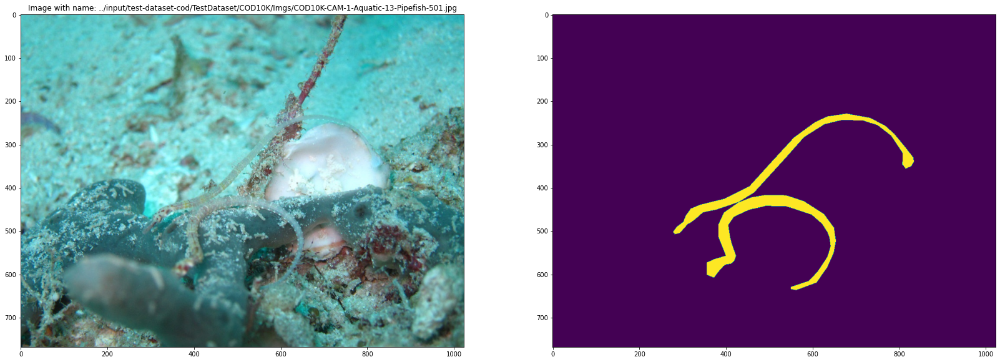

In [15]:
# showing an image from test-set from the Mixed Dataset
_, ax_main = plt.subplots(1, 2, figsize = (28, 12))
ax_main[0].set_title(f"Image with name: {test_images[42]}")
ax_main[0].imshow(Image.open(test_images[42]))
#ax_main[1].imshow(Image.open(test_images_gt_edge[55]))
#ax_main[2].imshow(Image.open(test_images_gt_instance[55]))
ax_main[1].imshow(Image.open(test_images_gt_object[42]));

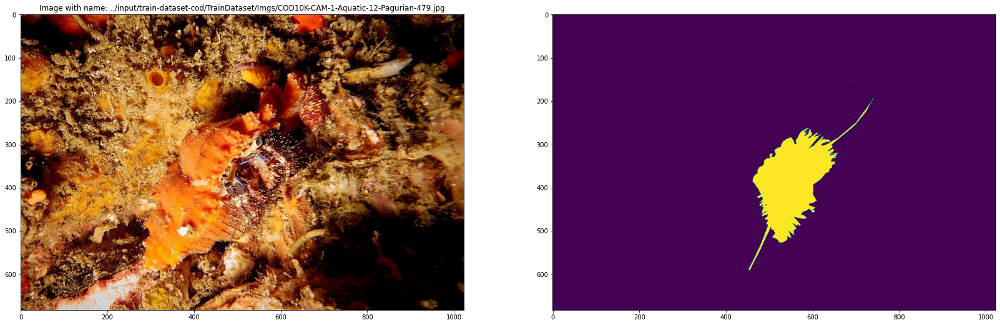

In [16]:
# showing an image from train-set from the Mixed Dataset
_, ax_main = plt.subplots(1, 2, figsize = (28, 12))
ax_main[0].set_title(f"Image with name: {train_images[42]}")
ax_main[0].imshow(Image.open(train_images[42]))
#ax_main[1].imshow(Image.open(train_images_gt_edge[42]))
#ax_main[2].imshow(Image.open(train_images_gt_instance[44]))
ax_main[1].imshow(Image.open(train_images_gt_object[42]));

## **Define Basic Training Functions**

In [17]:
def get_lr(optimizer):
    for param_group in optimizer.param_groups:
        return param_group['lr']

In [18]:
class CamObjDataset(data.Dataset):
    def __init__(self, train_images, train_images_gt, trainsize):
        self.trainsize = trainsize
        self.images = train_images
        self.gts = train_images_gt
        # train_images and train_images_gt have been initialized in the start of the notebook
        self.size = len(self.images)
        # all the transforms in the transforms.Compose are applied to the input one by one
        self.img_transform = transforms.Compose([
            transforms.Resize((self.trainsize, self.trainsize)),
            transforms.ToTensor(),
            transforms.Normalize([0.485, 0.456, 0.406],
                                 [0.229, 0.224, 0.225])])
        self.gt_transform = transforms.Compose([
            transforms.Resize((self.trainsize, self.trainsize)),
            transforms.ToTensor()])
        
    def __getitem__(self, index):
        image = Image.open(self.images[index])
        gt = Image.open(self.gts[index])
        image = image.convert('RGB')
        gt = gt.convert('L')
        image = self.img_transform(image)
        gt = self.gt_transform(gt)
        return image, gt

    def __len__(self):
        return self.size

In [19]:
def get_loader(image_root, gt_root, batchsize, trainsize, shuffle=True, num_workers=2, pin_memory=True):
    dataset = CamObjDataset(image_root, gt_root, trainsize)
    data_loader = data.DataLoader(dataset=dataset,
                                  batch_size=batchsize,
                                  shuffle=shuffle,
                                  num_workers=num_workers,
                                  pin_memory=pin_memory)
    return data_loader

In [20]:
def structure_loss(pred, mask):
    # BCE loss
    k = nn.Softmax2d()
    weit = torch.abs(pred - mask)
    weit = k(weit)
    wbce = F.binary_cross_entropy_with_logits(pred, mask, reduction='none')
    wbce = (weit * wbce).sum(dim=(2, 3))/weit.sum(dim=(2, 3))
    # IOU loss
    smooth = 1
    pred = torch.sigmoid(pred)
    inter = ((pred * mask) * weit).sum(dim=(2, 3))
    union = ((pred + mask) * weit).sum(dim=(2, 3))
    wiou = 1 - (inter + smooth) / (union - inter + smooth)

    return (wbce + wiou).mean()

In [21]:
def structure_loss(pred, mask):
    
    # BCE loss
    k = nn.Softmax2d()
    weit = torch.abs(pred - mask)
    weit = k(weit)
    wbce = F.binary_cross_entropy_with_logits(pred, mask, reduction='none')
    wbce = (weit * wbce).sum(dim=(2, 3))/weit.sum(dim=(2, 3))

    # IOU loss
    smooth = 1
    pred = torch.sigmoid(pred)
    inter = ((pred * mask) * weit).sum(dim=(2, 3))
    union = ((pred + mask) * weit).sum(dim=(2, 3))
    wiou = 1 - (inter + smooth) / (union - inter + smooth)

    return (wbce + wiou).mean()

def trainer(train_loader, model, optimizer, epoch, opt, total_step, scaler):
    all_dataset_loss_top = 0
    all_dataset_loss_top_bottom = 0
    iterations = 0
    for step, data_pack in tqdm(enumerate(train_loader)):
        optimizer.zero_grad()
        images, gts = data_pack
        # Variables are just wrappers for the tensors so we can easily auto compute the gradients.
        images = images.cuda(non_blocking=True)
        gts = gts.cuda(non_blocking=True)
        with torch.autocast(device_type='cuda', dtype=torch.float16):
            output_mask_top, output_mask_top_bottom = model(images)
            assert output_mask_top.dtype is torch.float16, "float16 Error From Model During Training"
            assert output_mask_top_bottom.dtype is torch.float16, "float16 Error From Model During Training"
            loss_top = structure_loss(output_mask_top, gts)
            loss_top_bottom = structure_loss(output_mask_top_bottom, gts)
            loss_total = loss_top + loss_top_bottom
            
            assert loss_total.dtype is torch.float32, "float32 Error From Optimizer During Training"
        
        scaler.scale(loss_total).backward()
    
        #scaler.unscale_(optimizer)
        #torch.nn.utils.clip_grad_norm_(model.parameters(), 0.5)
        
        scaler.step(optimizer)
        scaler.update()
        
        all_dataset_loss_top += loss_top.data
        all_dataset_loss_top_bottom += loss_top_bottom.data
        iterations += 1
        
        if step % 10 == 0 or step == total_step:
            print('[Epoch Num: {:03d}/{:03d}] => [Global Step: {:04d}/{:04d}] => [Loss_Top: {:.4f} Loss_Top_Bottom: {:0.4f}]'
                  .format(epoch, opt.epoch, step, total_step, loss_top.data, loss_top_bottom.data))
    
    average_loss_num_top = all_dataset_loss_top/iterations
    average_loss_num_top_bottom = all_dataset_loss_top_bottom/iterations
    print(f'[End of Epoch: {epoch}] => [Avr.Loss From Top Features => {average_loss_num_top:.4f}]')
    print(f'[End of Epoch: {epoch}] => [Avr.Loss From All  Features => {average_loss_num_top_bottom:.4f}]')
    save_path = opt.save_model
    os.makedirs(save_path, exist_ok=True)
    
    # save our model+opt+scale -> state
    checkpoint = {
    'model': model.state_dict(),
    'optimizer': optimizer.state_dict(),
    'scaler': scaler.state_dict()
    }
    torch.save(checkpoint, save_path + 'RACOD_checkpoint.pt')

In [22]:
print("Torch Version is: " + torch.__version__)
# GPU needs to be enabled for our model to be executed
print("Cuda Available" if torch.cuda.is_available() else "Cuda Not Available")
print(f"Cuda Version is: {torch.version.cuda if torch.cuda.is_available() else False}")
print ('Available devices ', torch.cuda.device_count())
print ('Current cuda device ', torch.cuda.current_device())

parser = argparse.ArgumentParser()
parser.add_argument('--epoch', type=int, default=39,
                    help='epoch number, default=39')
parser.add_argument('--lr', type=float, default=0.00002,
                    help='init learning rate, try `lr=0.000006`')
parser.add_argument('--batchsize', type=int, default=8,
                    help='training batch size')
parser.add_argument('--trainsize', type=int, default=456,
                    help='the size of training image, try small resolutions for speed (like 352 or 384)')
parser.add_argument('--gpu', type=int, default=0,
                    help='choose which gpu you use')

parser.add_argument('--save_model', type=str, default='Produced_Weights/RACOD/')
parser.add_argument('--train_img_dir', type=str, default='Training Directory From COD10K + CAMO')
parser.add_argument('--train_gt_dir', type=str, default='GT Objects Directory From COD10K + CAMO')
args = parser.parse_args("")

model = RACOD(
    img_size=args.trainsize,
    embed_dims=[64, 128, 320, 512],
    num_heads=[1, 2, 5, 8],
    mlp_ratios=[4, 4, 4, 4],
    qkv_bias=True,
    norm_layer=partial(nn.LayerNorm, eps=1e-6),
    #depths=[3, 6, 40, 3],
    depths=[3, 8, 27, 3],
    sr_ratios=[8, 4, 2, 1],
    drop_rate=0.0,
    drop_path_rate=0.0,
    decoder_channels=768,
    num_classes=1
).cuda()

optimizer = torch.optim.Adam(model.parameters(), args.lr, weight_decay=args.lr)
scheduler = torch.optim.lr_scheduler.CosineAnnealingWarmRestarts(optimizer, T_0=5, T_mult=6, eta_min=0.000006, last_epoch=-1)

train_loader = get_loader(train_images, train_images_gt_object, batchsize=args.batchsize,
                          trainsize=args.trainsize, num_workers=2)
total_step = len(train_loader)
print(f'\n', '*' * 30, "\n[Training Dataset INFO]\nimg_dir: {}\ngt_dir: {}\nLearning Rate: {}\nBatch_Size: {}\n"
                    "Image_Size: {}\nTraining_Epochs: {}\nTraining_Save: {}\nTotal_Num_Of_Images: {}\n".
                    format(args.train_img_dir, args.train_gt_dir, args.lr, args.batchsize, 
                    args.trainsize, args.epoch, args.save_model, total_step * args.batchsize), '*' * 30, f'\n')

Torch Version is: 1.12.1+cu102
Cuda Available
Cuda Version is: 10.2
Available devices  1
Current cuda device  0
*** Initializing Weights For ResNet50 Encoder ***


Downloading: "https://download.pytorch.org/models/resnet50-11ad3fa6.pth" to /root/.cache/torch/hub/checkpoints/resnet50-11ad3fa6.pth


  0%|          | 0.00/97.8M [00:00<?, ?B/s]

[INFO] Weights Initialized For Resnet50 From torchvision.models Trained In IMAGENET1K_V2
*** Initializing Weights For VisionTransformerEncoder ***
[INFO] Weights Initialized For MixVisionTransformerEncoder From mit_b4 Weights Trained In ImageNet-1K

 ****************************** 
[Training Dataset INFO]
img_dir: Training Directory From COD10K + CAMO
gt_dir: GT Objects Directory From COD10K + CAMO
Learning Rate: 2e-05
Batch_Size: 8
Image_Size: 456
Training_Epochs: 39
Training_Save: Produced_Weights/RACOD/
Total_Num_Of_Images: 4040
 ****************************** 



### **Training**

In [23]:
# initialize GradScaler instance since we are using Automatic Mixed Precision
scaler = torch.cuda.amp.GradScaler()
lrs = []

# total of args.epoch for training
for epoch_iter in tqdm(range(1, args.epoch + 1)):
    model.train(True)
    trainer(train_loader=train_loader, model=model,
            optimizer=optimizer, epoch=epoch_iter,
           opt=args, total_step=total_step, scaler=scaler)
    if epoch_iter >= 15:
        scheduler.step()

  0%|          | 0/39 [00:00<?, ?it/s]

0it [00:00, ?it/s]

[Epoch Num: 001/039] => [Global Step: 0000/0505] => [Loss_Top: 1.6250 Loss_Top_Bottom: 1.7489]
[Epoch Num: 001/039] => [Global Step: 0010/0505] => [Loss_Top: 1.3611 Loss_Top_Bottom: 1.0451]
[Epoch Num: 001/039] => [Global Step: 0020/0505] => [Loss_Top: 1.0820 Loss_Top_Bottom: 0.8133]
[Epoch Num: 001/039] => [Global Step: 0030/0505] => [Loss_Top: 1.2200 Loss_Top_Bottom: 0.7549]
[Epoch Num: 001/039] => [Global Step: 0040/0505] => [Loss_Top: 1.4541 Loss_Top_Bottom: 0.9447]
[Epoch Num: 001/039] => [Global Step: 0050/0505] => [Loss_Top: 1.1652 Loss_Top_Bottom: 0.7247]
[Epoch Num: 001/039] => [Global Step: 0060/0505] => [Loss_Top: 0.9676 Loss_Top_Bottom: 0.5864]
[Epoch Num: 001/039] => [Global Step: 0070/0505] => [Loss_Top: 1.1247 Loss_Top_Bottom: 0.6692]
[Epoch Num: 001/039] => [Global Step: 0080/0505] => [Loss_Top: 0.6873 Loss_Top_Bottom: 0.4677]
[Epoch Num: 001/039] => [Global Step: 0090/0505] => [Loss_Top: 0.8471 Loss_Top_Bottom: 0.4698]
[Epoch Num: 001/039] => [Global Step: 0100/0505] =

0it [00:00, ?it/s]

[Epoch Num: 002/039] => [Global Step: 0000/0505] => [Loss_Top: 0.7109 Loss_Top_Bottom: 0.5867]
[Epoch Num: 002/039] => [Global Step: 0010/0505] => [Loss_Top: 0.3015 Loss_Top_Bottom: 0.2289]
[Epoch Num: 002/039] => [Global Step: 0020/0505] => [Loss_Top: 0.4269 Loss_Top_Bottom: 0.3140]
[Epoch Num: 002/039] => [Global Step: 0030/0505] => [Loss_Top: 0.4079 Loss_Top_Bottom: 0.3139]
[Epoch Num: 002/039] => [Global Step: 0040/0505] => [Loss_Top: 0.4079 Loss_Top_Bottom: 0.3299]
[Epoch Num: 002/039] => [Global Step: 0050/0505] => [Loss_Top: 0.4291 Loss_Top_Bottom: 0.3319]
[Epoch Num: 002/039] => [Global Step: 0060/0505] => [Loss_Top: 0.4425 Loss_Top_Bottom: 0.3385]
[Epoch Num: 002/039] => [Global Step: 0070/0505] => [Loss_Top: 0.3779 Loss_Top_Bottom: 0.3230]
[Epoch Num: 002/039] => [Global Step: 0080/0505] => [Loss_Top: 0.4230 Loss_Top_Bottom: 0.3016]
[Epoch Num: 002/039] => [Global Step: 0090/0505] => [Loss_Top: 0.2712 Loss_Top_Bottom: 0.2056]
[Epoch Num: 002/039] => [Global Step: 0100/0505] =

0it [00:00, ?it/s]

[Epoch Num: 003/039] => [Global Step: 0000/0505] => [Loss_Top: 0.3827 Loss_Top_Bottom: 0.3021]
[Epoch Num: 003/039] => [Global Step: 0010/0505] => [Loss_Top: 0.4392 Loss_Top_Bottom: 0.3803]
[Epoch Num: 003/039] => [Global Step: 0020/0505] => [Loss_Top: 0.2693 Loss_Top_Bottom: 0.2594]
[Epoch Num: 003/039] => [Global Step: 0030/0505] => [Loss_Top: 0.2600 Loss_Top_Bottom: 0.2313]
[Epoch Num: 003/039] => [Global Step: 0040/0505] => [Loss_Top: 0.2660 Loss_Top_Bottom: 0.2569]
[Epoch Num: 003/039] => [Global Step: 0050/0505] => [Loss_Top: 0.4596 Loss_Top_Bottom: 0.4388]
[Epoch Num: 003/039] => [Global Step: 0060/0505] => [Loss_Top: 0.3364 Loss_Top_Bottom: 0.2722]
[Epoch Num: 003/039] => [Global Step: 0070/0505] => [Loss_Top: 0.3395 Loss_Top_Bottom: 0.3116]
[Epoch Num: 003/039] => [Global Step: 0080/0505] => [Loss_Top: 0.2384 Loss_Top_Bottom: 0.2103]
[Epoch Num: 003/039] => [Global Step: 0090/0505] => [Loss_Top: 0.3019 Loss_Top_Bottom: 0.2713]
[Epoch Num: 003/039] => [Global Step: 0100/0505] =

0it [00:00, ?it/s]

[Epoch Num: 004/039] => [Global Step: 0000/0505] => [Loss_Top: 0.1985 Loss_Top_Bottom: 0.1828]
[Epoch Num: 004/039] => [Global Step: 0010/0505] => [Loss_Top: 0.3563 Loss_Top_Bottom: 0.3511]
[Epoch Num: 004/039] => [Global Step: 0020/0505] => [Loss_Top: 0.3737 Loss_Top_Bottom: 0.3614]
[Epoch Num: 004/039] => [Global Step: 0030/0505] => [Loss_Top: 0.2611 Loss_Top_Bottom: 0.2504]
[Epoch Num: 004/039] => [Global Step: 0040/0505] => [Loss_Top: 0.1666 Loss_Top_Bottom: 0.1537]
[Epoch Num: 004/039] => [Global Step: 0050/0505] => [Loss_Top: 0.3142 Loss_Top_Bottom: 0.2894]
[Epoch Num: 004/039] => [Global Step: 0060/0505] => [Loss_Top: 0.3456 Loss_Top_Bottom: 0.3228]
[Epoch Num: 004/039] => [Global Step: 0070/0505] => [Loss_Top: 0.2639 Loss_Top_Bottom: 0.2331]
[Epoch Num: 004/039] => [Global Step: 0080/0505] => [Loss_Top: 0.3907 Loss_Top_Bottom: 0.3470]
[Epoch Num: 004/039] => [Global Step: 0090/0505] => [Loss_Top: 0.1586 Loss_Top_Bottom: 0.1441]
[Epoch Num: 004/039] => [Global Step: 0100/0505] =

0it [00:00, ?it/s]

[Epoch Num: 005/039] => [Global Step: 0000/0505] => [Loss_Top: 0.2482 Loss_Top_Bottom: 0.2323]
[Epoch Num: 005/039] => [Global Step: 0010/0505] => [Loss_Top: 0.2662 Loss_Top_Bottom: 0.2480]
[Epoch Num: 005/039] => [Global Step: 0020/0505] => [Loss_Top: 0.2796 Loss_Top_Bottom: 0.2629]
[Epoch Num: 005/039] => [Global Step: 0030/0505] => [Loss_Top: 0.2206 Loss_Top_Bottom: 0.2141]
[Epoch Num: 005/039] => [Global Step: 0040/0505] => [Loss_Top: 0.1779 Loss_Top_Bottom: 0.1564]
[Epoch Num: 005/039] => [Global Step: 0050/0505] => [Loss_Top: 0.1968 Loss_Top_Bottom: 0.1779]
[Epoch Num: 005/039] => [Global Step: 0060/0505] => [Loss_Top: 0.2170 Loss_Top_Bottom: 0.2120]
[Epoch Num: 005/039] => [Global Step: 0070/0505] => [Loss_Top: 0.3880 Loss_Top_Bottom: 0.3776]
[Epoch Num: 005/039] => [Global Step: 0080/0505] => [Loss_Top: 0.3576 Loss_Top_Bottom: 0.3453]
[Epoch Num: 005/039] => [Global Step: 0090/0505] => [Loss_Top: 0.2013 Loss_Top_Bottom: 0.1885]
[Epoch Num: 005/039] => [Global Step: 0100/0505] =

0it [00:00, ?it/s]

[Epoch Num: 006/039] => [Global Step: 0000/0505] => [Loss_Top: 0.2980 Loss_Top_Bottom: 0.2951]
[Epoch Num: 006/039] => [Global Step: 0010/0505] => [Loss_Top: 0.2804 Loss_Top_Bottom: 0.2682]
[Epoch Num: 006/039] => [Global Step: 0020/0505] => [Loss_Top: 0.1949 Loss_Top_Bottom: 0.1870]
[Epoch Num: 006/039] => [Global Step: 0030/0505] => [Loss_Top: 0.2497 Loss_Top_Bottom: 0.2362]
[Epoch Num: 006/039] => [Global Step: 0040/0505] => [Loss_Top: 0.2509 Loss_Top_Bottom: 0.2351]
[Epoch Num: 006/039] => [Global Step: 0050/0505] => [Loss_Top: 0.2693 Loss_Top_Bottom: 0.2513]
[Epoch Num: 006/039] => [Global Step: 0060/0505] => [Loss_Top: 0.1478 Loss_Top_Bottom: 0.1439]
[Epoch Num: 006/039] => [Global Step: 0070/0505] => [Loss_Top: 0.1745 Loss_Top_Bottom: 0.1713]
[Epoch Num: 006/039] => [Global Step: 0080/0505] => [Loss_Top: 0.2781 Loss_Top_Bottom: 0.2631]
[Epoch Num: 006/039] => [Global Step: 0090/0505] => [Loss_Top: 0.2273 Loss_Top_Bottom: 0.2133]
[Epoch Num: 006/039] => [Global Step: 0100/0505] =

0it [00:00, ?it/s]

[Epoch Num: 007/039] => [Global Step: 0000/0505] => [Loss_Top: 0.2679 Loss_Top_Bottom: 0.2559]
[Epoch Num: 007/039] => [Global Step: 0010/0505] => [Loss_Top: 0.2439 Loss_Top_Bottom: 0.2306]
[Epoch Num: 007/039] => [Global Step: 0020/0505] => [Loss_Top: 0.2311 Loss_Top_Bottom: 0.2136]
[Epoch Num: 007/039] => [Global Step: 0030/0505] => [Loss_Top: 0.2407 Loss_Top_Bottom: 0.2195]
[Epoch Num: 007/039] => [Global Step: 0040/0505] => [Loss_Top: 0.3597 Loss_Top_Bottom: 0.3546]
[Epoch Num: 007/039] => [Global Step: 0050/0505] => [Loss_Top: 0.2151 Loss_Top_Bottom: 0.2089]
[Epoch Num: 007/039] => [Global Step: 0060/0505] => [Loss_Top: 0.3115 Loss_Top_Bottom: 0.2882]
[Epoch Num: 007/039] => [Global Step: 0070/0505] => [Loss_Top: 0.1919 Loss_Top_Bottom: 0.1809]
[Epoch Num: 007/039] => [Global Step: 0080/0505] => [Loss_Top: 0.2189 Loss_Top_Bottom: 0.2018]
[Epoch Num: 007/039] => [Global Step: 0090/0505] => [Loss_Top: 0.2269 Loss_Top_Bottom: 0.2192]
[Epoch Num: 007/039] => [Global Step: 0100/0505] =

0it [00:00, ?it/s]

[Epoch Num: 008/039] => [Global Step: 0000/0505] => [Loss_Top: 0.1695 Loss_Top_Bottom: 0.1509]
[Epoch Num: 008/039] => [Global Step: 0010/0505] => [Loss_Top: 0.1519 Loss_Top_Bottom: 0.1447]
[Epoch Num: 008/039] => [Global Step: 0020/0505] => [Loss_Top: 0.1699 Loss_Top_Bottom: 0.1597]
[Epoch Num: 008/039] => [Global Step: 0030/0505] => [Loss_Top: 0.1877 Loss_Top_Bottom: 0.1835]
[Epoch Num: 008/039] => [Global Step: 0040/0505] => [Loss_Top: 0.3519 Loss_Top_Bottom: 0.3421]
[Epoch Num: 008/039] => [Global Step: 0050/0505] => [Loss_Top: 0.2104 Loss_Top_Bottom: 0.2022]
[Epoch Num: 008/039] => [Global Step: 0060/0505] => [Loss_Top: 0.2232 Loss_Top_Bottom: 0.2107]
[Epoch Num: 008/039] => [Global Step: 0070/0505] => [Loss_Top: 0.1552 Loss_Top_Bottom: 0.1458]
[Epoch Num: 008/039] => [Global Step: 0080/0505] => [Loss_Top: 0.2079 Loss_Top_Bottom: 0.1971]
[Epoch Num: 008/039] => [Global Step: 0090/0505] => [Loss_Top: 0.2923 Loss_Top_Bottom: 0.2807]
[Epoch Num: 008/039] => [Global Step: 0100/0505] =

0it [00:00, ?it/s]

[Epoch Num: 009/039] => [Global Step: 0000/0505] => [Loss_Top: 0.1533 Loss_Top_Bottom: 0.1453]
[Epoch Num: 009/039] => [Global Step: 0010/0505] => [Loss_Top: 0.1918 Loss_Top_Bottom: 0.1818]
[Epoch Num: 009/039] => [Global Step: 0020/0505] => [Loss_Top: 0.1883 Loss_Top_Bottom: 0.1767]
[Epoch Num: 009/039] => [Global Step: 0030/0505] => [Loss_Top: 0.1694 Loss_Top_Bottom: 0.1585]
[Epoch Num: 009/039] => [Global Step: 0040/0505] => [Loss_Top: 0.2084 Loss_Top_Bottom: 0.2009]
[Epoch Num: 009/039] => [Global Step: 0050/0505] => [Loss_Top: 0.1458 Loss_Top_Bottom: 0.1394]
[Epoch Num: 009/039] => [Global Step: 0060/0505] => [Loss_Top: 0.2567 Loss_Top_Bottom: 0.2428]
[Epoch Num: 009/039] => [Global Step: 0070/0505] => [Loss_Top: 0.1852 Loss_Top_Bottom: 0.1709]
[Epoch Num: 009/039] => [Global Step: 0080/0505] => [Loss_Top: 0.2574 Loss_Top_Bottom: 0.2439]
[Epoch Num: 009/039] => [Global Step: 0090/0505] => [Loss_Top: 0.2732 Loss_Top_Bottom: 0.2695]
[Epoch Num: 009/039] => [Global Step: 0100/0505] =

0it [00:00, ?it/s]

[Epoch Num: 010/039] => [Global Step: 0000/0505] => [Loss_Top: 0.2234 Loss_Top_Bottom: 0.2111]
[Epoch Num: 010/039] => [Global Step: 0010/0505] => [Loss_Top: 0.2324 Loss_Top_Bottom: 0.2225]
[Epoch Num: 010/039] => [Global Step: 0020/0505] => [Loss_Top: 0.2266 Loss_Top_Bottom: 0.2247]
[Epoch Num: 010/039] => [Global Step: 0030/0505] => [Loss_Top: 0.1699 Loss_Top_Bottom: 0.1584]
[Epoch Num: 010/039] => [Global Step: 0040/0505] => [Loss_Top: 0.1716 Loss_Top_Bottom: 0.1598]
[Epoch Num: 010/039] => [Global Step: 0050/0505] => [Loss_Top: 0.2328 Loss_Top_Bottom: 0.2252]
[Epoch Num: 010/039] => [Global Step: 0060/0505] => [Loss_Top: 0.1802 Loss_Top_Bottom: 0.1703]
[Epoch Num: 010/039] => [Global Step: 0070/0505] => [Loss_Top: 0.1632 Loss_Top_Bottom: 0.1555]
[Epoch Num: 010/039] => [Global Step: 0080/0505] => [Loss_Top: 0.1660 Loss_Top_Bottom: 0.1570]
[Epoch Num: 010/039] => [Global Step: 0090/0505] => [Loss_Top: 0.2933 Loss_Top_Bottom: 0.2752]
[Epoch Num: 010/039] => [Global Step: 0100/0505] =

0it [00:00, ?it/s]

[Epoch Num: 011/039] => [Global Step: 0000/0505] => [Loss_Top: 0.1657 Loss_Top_Bottom: 0.1533]
[Epoch Num: 011/039] => [Global Step: 0010/0505] => [Loss_Top: 0.1837 Loss_Top_Bottom: 0.1732]
[Epoch Num: 011/039] => [Global Step: 0020/0505] => [Loss_Top: 0.1459 Loss_Top_Bottom: 0.1344]
[Epoch Num: 011/039] => [Global Step: 0030/0505] => [Loss_Top: 0.1851 Loss_Top_Bottom: 0.1706]
[Epoch Num: 011/039] => [Global Step: 0040/0505] => [Loss_Top: 0.1074 Loss_Top_Bottom: 0.1033]
[Epoch Num: 011/039] => [Global Step: 0050/0505] => [Loss_Top: 0.1851 Loss_Top_Bottom: 0.1716]
[Epoch Num: 011/039] => [Global Step: 0060/0505] => [Loss_Top: 0.1934 Loss_Top_Bottom: 0.1768]
[Epoch Num: 011/039] => [Global Step: 0070/0505] => [Loss_Top: 0.1561 Loss_Top_Bottom: 0.1402]
[Epoch Num: 011/039] => [Global Step: 0080/0505] => [Loss_Top: 0.2399 Loss_Top_Bottom: 0.2252]
[Epoch Num: 011/039] => [Global Step: 0090/0505] => [Loss_Top: 0.1497 Loss_Top_Bottom: 0.1437]
[Epoch Num: 011/039] => [Global Step: 0100/0505] =

0it [00:00, ?it/s]

[Epoch Num: 012/039] => [Global Step: 0000/0505] => [Loss_Top: 0.1742 Loss_Top_Bottom: 0.1649]
[Epoch Num: 012/039] => [Global Step: 0010/0505] => [Loss_Top: 0.1921 Loss_Top_Bottom: 0.1758]
[Epoch Num: 012/039] => [Global Step: 0020/0505] => [Loss_Top: 0.1426 Loss_Top_Bottom: 0.1305]
[Epoch Num: 012/039] => [Global Step: 0030/0505] => [Loss_Top: 0.2030 Loss_Top_Bottom: 0.1910]
[Epoch Num: 012/039] => [Global Step: 0040/0505] => [Loss_Top: 0.2795 Loss_Top_Bottom: 0.2720]
[Epoch Num: 012/039] => [Global Step: 0050/0505] => [Loss_Top: 0.2034 Loss_Top_Bottom: 0.1890]
[Epoch Num: 012/039] => [Global Step: 0060/0505] => [Loss_Top: 0.2491 Loss_Top_Bottom: 0.2359]
[Epoch Num: 012/039] => [Global Step: 0070/0505] => [Loss_Top: 0.1817 Loss_Top_Bottom: 0.1715]
[Epoch Num: 012/039] => [Global Step: 0080/0505] => [Loss_Top: 0.1794 Loss_Top_Bottom: 0.1707]
[Epoch Num: 012/039] => [Global Step: 0090/0505] => [Loss_Top: 0.1911 Loss_Top_Bottom: 0.1789]
[Epoch Num: 012/039] => [Global Step: 0100/0505] =

0it [00:00, ?it/s]

[Epoch Num: 013/039] => [Global Step: 0000/0505] => [Loss_Top: 0.3040 Loss_Top_Bottom: 0.2845]
[Epoch Num: 013/039] => [Global Step: 0010/0505] => [Loss_Top: 0.1189 Loss_Top_Bottom: 0.1062]
[Epoch Num: 013/039] => [Global Step: 0020/0505] => [Loss_Top: 0.2951 Loss_Top_Bottom: 0.2792]
[Epoch Num: 013/039] => [Global Step: 0030/0505] => [Loss_Top: 0.1457 Loss_Top_Bottom: 0.1373]
[Epoch Num: 013/039] => [Global Step: 0040/0505] => [Loss_Top: 0.1571 Loss_Top_Bottom: 0.1493]
[Epoch Num: 013/039] => [Global Step: 0050/0505] => [Loss_Top: 0.1249 Loss_Top_Bottom: 0.1148]
[Epoch Num: 013/039] => [Global Step: 0060/0505] => [Loss_Top: 0.1737 Loss_Top_Bottom: 0.1578]
[Epoch Num: 013/039] => [Global Step: 0070/0505] => [Loss_Top: 0.1546 Loss_Top_Bottom: 0.1441]
[Epoch Num: 013/039] => [Global Step: 0080/0505] => [Loss_Top: 0.2383 Loss_Top_Bottom: 0.2246]
[Epoch Num: 013/039] => [Global Step: 0090/0505] => [Loss_Top: 0.1670 Loss_Top_Bottom: 0.1559]
[Epoch Num: 013/039] => [Global Step: 0100/0505] =

0it [00:00, ?it/s]

[Epoch Num: 014/039] => [Global Step: 0000/0505] => [Loss_Top: 0.1583 Loss_Top_Bottom: 0.1459]
[Epoch Num: 014/039] => [Global Step: 0010/0505] => [Loss_Top: 0.1793 Loss_Top_Bottom: 0.1696]
[Epoch Num: 014/039] => [Global Step: 0020/0505] => [Loss_Top: 0.1481 Loss_Top_Bottom: 0.1387]
[Epoch Num: 014/039] => [Global Step: 0030/0505] => [Loss_Top: 0.1315 Loss_Top_Bottom: 0.1228]
[Epoch Num: 014/039] => [Global Step: 0040/0505] => [Loss_Top: 0.1717 Loss_Top_Bottom: 0.1623]
[Epoch Num: 014/039] => [Global Step: 0050/0505] => [Loss_Top: 0.1495 Loss_Top_Bottom: 0.1323]
[Epoch Num: 014/039] => [Global Step: 0060/0505] => [Loss_Top: 0.1155 Loss_Top_Bottom: 0.1028]
[Epoch Num: 014/039] => [Global Step: 0070/0505] => [Loss_Top: 0.2326 Loss_Top_Bottom: 0.1885]
[Epoch Num: 014/039] => [Global Step: 0080/0505] => [Loss_Top: 0.1421 Loss_Top_Bottom: 0.1226]
[Epoch Num: 014/039] => [Global Step: 0090/0505] => [Loss_Top: 0.1974 Loss_Top_Bottom: 0.1840]
[Epoch Num: 014/039] => [Global Step: 0100/0505] =

0it [00:00, ?it/s]

[Epoch Num: 015/039] => [Global Step: 0000/0505] => [Loss_Top: 0.1743 Loss_Top_Bottom: 0.1635]
[Epoch Num: 015/039] => [Global Step: 0010/0505] => [Loss_Top: 0.0822 Loss_Top_Bottom: 0.0732]
[Epoch Num: 015/039] => [Global Step: 0020/0505] => [Loss_Top: 0.1713 Loss_Top_Bottom: 0.1603]
[Epoch Num: 015/039] => [Global Step: 0030/0505] => [Loss_Top: 0.1630 Loss_Top_Bottom: 0.1521]
[Epoch Num: 015/039] => [Global Step: 0040/0505] => [Loss_Top: 0.2284 Loss_Top_Bottom: 0.2057]
[Epoch Num: 015/039] => [Global Step: 0050/0505] => [Loss_Top: 0.1681 Loss_Top_Bottom: 0.1565]
[Epoch Num: 015/039] => [Global Step: 0060/0505] => [Loss_Top: 0.1784 Loss_Top_Bottom: 0.1641]
[Epoch Num: 015/039] => [Global Step: 0070/0505] => [Loss_Top: 0.0804 Loss_Top_Bottom: 0.0741]
[Epoch Num: 015/039] => [Global Step: 0080/0505] => [Loss_Top: 0.1468 Loss_Top_Bottom: 0.1291]
[Epoch Num: 015/039] => [Global Step: 0090/0505] => [Loss_Top: 0.0956 Loss_Top_Bottom: 0.0891]
[Epoch Num: 015/039] => [Global Step: 0100/0505] =

0it [00:00, ?it/s]

[Epoch Num: 016/039] => [Global Step: 0000/0505] => [Loss_Top: 0.0868 Loss_Top_Bottom: 0.0801]
[Epoch Num: 016/039] => [Global Step: 0010/0505] => [Loss_Top: 0.1181 Loss_Top_Bottom: 0.1094]
[Epoch Num: 016/039] => [Global Step: 0020/0505] => [Loss_Top: 0.1032 Loss_Top_Bottom: 0.0965]
[Epoch Num: 016/039] => [Global Step: 0030/0505] => [Loss_Top: 0.1631 Loss_Top_Bottom: 0.1473]
[Epoch Num: 016/039] => [Global Step: 0040/0505] => [Loss_Top: 0.1300 Loss_Top_Bottom: 0.1198]
[Epoch Num: 016/039] => [Global Step: 0050/0505] => [Loss_Top: 0.1095 Loss_Top_Bottom: 0.0980]
[Epoch Num: 016/039] => [Global Step: 0060/0505] => [Loss_Top: 0.1265 Loss_Top_Bottom: 0.1146]
[Epoch Num: 016/039] => [Global Step: 0070/0505] => [Loss_Top: 0.1069 Loss_Top_Bottom: 0.0966]
[Epoch Num: 016/039] => [Global Step: 0080/0505] => [Loss_Top: 0.1242 Loss_Top_Bottom: 0.1148]
[Epoch Num: 016/039] => [Global Step: 0090/0505] => [Loss_Top: 0.1531 Loss_Top_Bottom: 0.1410]
[Epoch Num: 016/039] => [Global Step: 0100/0505] =

0it [00:00, ?it/s]

[Epoch Num: 017/039] => [Global Step: 0000/0505] => [Loss_Top: 0.1904 Loss_Top_Bottom: 0.1772]
[Epoch Num: 017/039] => [Global Step: 0010/0505] => [Loss_Top: 0.1582 Loss_Top_Bottom: 0.1443]
[Epoch Num: 017/039] => [Global Step: 0020/0505] => [Loss_Top: 0.1237 Loss_Top_Bottom: 0.1176]
[Epoch Num: 017/039] => [Global Step: 0030/0505] => [Loss_Top: 0.1866 Loss_Top_Bottom: 0.1758]
[Epoch Num: 017/039] => [Global Step: 0040/0505] => [Loss_Top: 0.1275 Loss_Top_Bottom: 0.1186]
[Epoch Num: 017/039] => [Global Step: 0050/0505] => [Loss_Top: 0.0967 Loss_Top_Bottom: 0.0894]
[Epoch Num: 017/039] => [Global Step: 0060/0505] => [Loss_Top: 0.1490 Loss_Top_Bottom: 0.1351]
[Epoch Num: 017/039] => [Global Step: 0070/0505] => [Loss_Top: 0.1491 Loss_Top_Bottom: 0.1378]
[Epoch Num: 017/039] => [Global Step: 0080/0505] => [Loss_Top: 0.1469 Loss_Top_Bottom: 0.1327]
[Epoch Num: 017/039] => [Global Step: 0090/0505] => [Loss_Top: 0.1578 Loss_Top_Bottom: 0.1459]
[Epoch Num: 017/039] => [Global Step: 0100/0505] =

0it [00:00, ?it/s]

[Epoch Num: 018/039] => [Global Step: 0000/0505] => [Loss_Top: 0.1590 Loss_Top_Bottom: 0.1505]
[Epoch Num: 018/039] => [Global Step: 0010/0505] => [Loss_Top: 0.1597 Loss_Top_Bottom: 0.1502]
[Epoch Num: 018/039] => [Global Step: 0020/0505] => [Loss_Top: 0.1479 Loss_Top_Bottom: 0.1390]
[Epoch Num: 018/039] => [Global Step: 0030/0505] => [Loss_Top: 0.0908 Loss_Top_Bottom: 0.0799]
[Epoch Num: 018/039] => [Global Step: 0040/0505] => [Loss_Top: 0.1338 Loss_Top_Bottom: 0.1265]
[Epoch Num: 018/039] => [Global Step: 0050/0505] => [Loss_Top: 0.1481 Loss_Top_Bottom: 0.1373]
[Epoch Num: 018/039] => [Global Step: 0060/0505] => [Loss_Top: 0.1082 Loss_Top_Bottom: 0.1021]
[Epoch Num: 018/039] => [Global Step: 0070/0505] => [Loss_Top: 0.1184 Loss_Top_Bottom: 0.1056]
[Epoch Num: 018/039] => [Global Step: 0080/0505] => [Loss_Top: 0.2350 Loss_Top_Bottom: 0.2225]
[Epoch Num: 018/039] => [Global Step: 0090/0505] => [Loss_Top: 0.1271 Loss_Top_Bottom: 0.1154]
[Epoch Num: 018/039] => [Global Step: 0100/0505] =

0it [00:00, ?it/s]

[Epoch Num: 019/039] => [Global Step: 0000/0505] => [Loss_Top: 0.1318 Loss_Top_Bottom: 0.1223]
[Epoch Num: 019/039] => [Global Step: 0010/0505] => [Loss_Top: 0.1041 Loss_Top_Bottom: 0.0919]
[Epoch Num: 019/039] => [Global Step: 0020/0505] => [Loss_Top: 0.1618 Loss_Top_Bottom: 0.1477]
[Epoch Num: 019/039] => [Global Step: 0030/0505] => [Loss_Top: 0.1583 Loss_Top_Bottom: 0.1450]
[Epoch Num: 019/039] => [Global Step: 0040/0505] => [Loss_Top: 0.1805 Loss_Top_Bottom: 0.1666]
[Epoch Num: 019/039] => [Global Step: 0050/0505] => [Loss_Top: 0.0904 Loss_Top_Bottom: 0.0813]
[Epoch Num: 019/039] => [Global Step: 0060/0505] => [Loss_Top: 0.1045 Loss_Top_Bottom: 0.0919]
[Epoch Num: 019/039] => [Global Step: 0070/0505] => [Loss_Top: 0.1312 Loss_Top_Bottom: 0.1192]
[Epoch Num: 019/039] => [Global Step: 0080/0505] => [Loss_Top: 0.0808 Loss_Top_Bottom: 0.0731]
[Epoch Num: 019/039] => [Global Step: 0090/0505] => [Loss_Top: 0.1900 Loss_Top_Bottom: 0.1749]
[Epoch Num: 019/039] => [Global Step: 0100/0505] =

0it [00:00, ?it/s]

[Epoch Num: 020/039] => [Global Step: 0000/0505] => [Loss_Top: 0.0798 Loss_Top_Bottom: 0.0727]
[Epoch Num: 020/039] => [Global Step: 0010/0505] => [Loss_Top: 0.1001 Loss_Top_Bottom: 0.0902]
[Epoch Num: 020/039] => [Global Step: 0020/0505] => [Loss_Top: 0.1746 Loss_Top_Bottom: 0.1637]
[Epoch Num: 020/039] => [Global Step: 0030/0505] => [Loss_Top: 0.1109 Loss_Top_Bottom: 0.1020]
[Epoch Num: 020/039] => [Global Step: 0040/0505] => [Loss_Top: 0.2515 Loss_Top_Bottom: 0.2435]
[Epoch Num: 020/039] => [Global Step: 0050/0505] => [Loss_Top: 0.1118 Loss_Top_Bottom: 0.1018]
[Epoch Num: 020/039] => [Global Step: 0060/0505] => [Loss_Top: 0.1881 Loss_Top_Bottom: 0.1769]
[Epoch Num: 020/039] => [Global Step: 0070/0505] => [Loss_Top: 0.1257 Loss_Top_Bottom: 0.1116]
[Epoch Num: 020/039] => [Global Step: 0080/0505] => [Loss_Top: 0.1147 Loss_Top_Bottom: 0.1062]
[Epoch Num: 020/039] => [Global Step: 0090/0505] => [Loss_Top: 0.1342 Loss_Top_Bottom: 0.1227]
[Epoch Num: 020/039] => [Global Step: 0100/0505] =

0it [00:00, ?it/s]

[Epoch Num: 021/039] => [Global Step: 0000/0505] => [Loss_Top: 0.1700 Loss_Top_Bottom: 0.1675]
[Epoch Num: 021/039] => [Global Step: 0010/0505] => [Loss_Top: 0.1178 Loss_Top_Bottom: 0.1116]
[Epoch Num: 021/039] => [Global Step: 0020/0505] => [Loss_Top: 0.1118 Loss_Top_Bottom: 0.1027]
[Epoch Num: 021/039] => [Global Step: 0030/0505] => [Loss_Top: 0.1410 Loss_Top_Bottom: 0.1302]
[Epoch Num: 021/039] => [Global Step: 0040/0505] => [Loss_Top: 0.1722 Loss_Top_Bottom: 0.1542]
[Epoch Num: 021/039] => [Global Step: 0050/0505] => [Loss_Top: 0.1474 Loss_Top_Bottom: 0.1334]
[Epoch Num: 021/039] => [Global Step: 0060/0505] => [Loss_Top: 0.1530 Loss_Top_Bottom: 0.1419]
[Epoch Num: 021/039] => [Global Step: 0070/0505] => [Loss_Top: 0.1467 Loss_Top_Bottom: 0.1411]
[Epoch Num: 021/039] => [Global Step: 0080/0505] => [Loss_Top: 0.1433 Loss_Top_Bottom: 0.1338]
[Epoch Num: 021/039] => [Global Step: 0090/0505] => [Loss_Top: 0.0867 Loss_Top_Bottom: 0.0787]
[Epoch Num: 021/039] => [Global Step: 0100/0505] =

0it [00:00, ?it/s]

[Epoch Num: 022/039] => [Global Step: 0000/0505] => [Loss_Top: 0.1134 Loss_Top_Bottom: 0.1043]
[Epoch Num: 022/039] => [Global Step: 0010/0505] => [Loss_Top: 0.1346 Loss_Top_Bottom: 0.1236]
[Epoch Num: 022/039] => [Global Step: 0020/0505] => [Loss_Top: 0.1416 Loss_Top_Bottom: 0.1308]
[Epoch Num: 022/039] => [Global Step: 0030/0505] => [Loss_Top: 0.1345 Loss_Top_Bottom: 0.1206]
[Epoch Num: 022/039] => [Global Step: 0040/0505] => [Loss_Top: 0.1214 Loss_Top_Bottom: 0.1088]
[Epoch Num: 022/039] => [Global Step: 0050/0505] => [Loss_Top: 0.1566 Loss_Top_Bottom: 0.1431]
[Epoch Num: 022/039] => [Global Step: 0060/0505] => [Loss_Top: 0.1511 Loss_Top_Bottom: 0.1402]
[Epoch Num: 022/039] => [Global Step: 0070/0505] => [Loss_Top: 0.0824 Loss_Top_Bottom: 0.0736]
[Epoch Num: 022/039] => [Global Step: 0080/0505] => [Loss_Top: 0.0814 Loss_Top_Bottom: 0.0724]
[Epoch Num: 022/039] => [Global Step: 0090/0505] => [Loss_Top: 0.2243 Loss_Top_Bottom: 0.2086]
[Epoch Num: 022/039] => [Global Step: 0100/0505] =

0it [00:00, ?it/s]

[Epoch Num: 023/039] => [Global Step: 0000/0505] => [Loss_Top: 0.2069 Loss_Top_Bottom: 0.1990]
[Epoch Num: 023/039] => [Global Step: 0010/0505] => [Loss_Top: 0.0891 Loss_Top_Bottom: 0.0814]
[Epoch Num: 023/039] => [Global Step: 0020/0505] => [Loss_Top: 0.1125 Loss_Top_Bottom: 0.0982]
[Epoch Num: 023/039] => [Global Step: 0030/0505] => [Loss_Top: 0.1833 Loss_Top_Bottom: 0.1723]
[Epoch Num: 023/039] => [Global Step: 0040/0505] => [Loss_Top: 0.1597 Loss_Top_Bottom: 0.1505]
[Epoch Num: 023/039] => [Global Step: 0050/0505] => [Loss_Top: 0.1542 Loss_Top_Bottom: 0.1457]
[Epoch Num: 023/039] => [Global Step: 0060/0505] => [Loss_Top: 0.1157 Loss_Top_Bottom: 0.1036]
[Epoch Num: 023/039] => [Global Step: 0070/0505] => [Loss_Top: 0.1158 Loss_Top_Bottom: 0.1052]
[Epoch Num: 023/039] => [Global Step: 0080/0505] => [Loss_Top: 0.1181 Loss_Top_Bottom: 0.1109]
[Epoch Num: 023/039] => [Global Step: 0090/0505] => [Loss_Top: 0.0833 Loss_Top_Bottom: 0.0722]
[Epoch Num: 023/039] => [Global Step: 0100/0505] =

0it [00:00, ?it/s]

[Epoch Num: 024/039] => [Global Step: 0000/0505] => [Loss_Top: 0.1141 Loss_Top_Bottom: 0.1097]
[Epoch Num: 024/039] => [Global Step: 0010/0505] => [Loss_Top: 0.2528 Loss_Top_Bottom: 0.2396]
[Epoch Num: 024/039] => [Global Step: 0020/0505] => [Loss_Top: 0.1003 Loss_Top_Bottom: 0.0875]
[Epoch Num: 024/039] => [Global Step: 0030/0505] => [Loss_Top: 0.1801 Loss_Top_Bottom: 0.1654]
[Epoch Num: 024/039] => [Global Step: 0040/0505] => [Loss_Top: 0.1732 Loss_Top_Bottom: 0.1600]
[Epoch Num: 024/039] => [Global Step: 0050/0505] => [Loss_Top: 0.1030 Loss_Top_Bottom: 0.0931]
[Epoch Num: 024/039] => [Global Step: 0060/0505] => [Loss_Top: 0.0980 Loss_Top_Bottom: 0.0902]
[Epoch Num: 024/039] => [Global Step: 0070/0505] => [Loss_Top: 0.1383 Loss_Top_Bottom: 0.1322]
[Epoch Num: 024/039] => [Global Step: 0080/0505] => [Loss_Top: 0.0729 Loss_Top_Bottom: 0.0659]
[Epoch Num: 024/039] => [Global Step: 0090/0505] => [Loss_Top: 0.1074 Loss_Top_Bottom: 0.0991]
[Epoch Num: 024/039] => [Global Step: 0100/0505] =

0it [00:00, ?it/s]

[Epoch Num: 025/039] => [Global Step: 0000/0505] => [Loss_Top: 0.1253 Loss_Top_Bottom: 0.1189]
[Epoch Num: 025/039] => [Global Step: 0010/0505] => [Loss_Top: 0.1200 Loss_Top_Bottom: 0.1141]
[Epoch Num: 025/039] => [Global Step: 0020/0505] => [Loss_Top: 0.0948 Loss_Top_Bottom: 0.0881]
[Epoch Num: 025/039] => [Global Step: 0030/0505] => [Loss_Top: 0.1203 Loss_Top_Bottom: 0.1087]
[Epoch Num: 025/039] => [Global Step: 0040/0505] => [Loss_Top: 0.1172 Loss_Top_Bottom: 0.1125]
[Epoch Num: 025/039] => [Global Step: 0050/0505] => [Loss_Top: 0.1385 Loss_Top_Bottom: 0.1281]
[Epoch Num: 025/039] => [Global Step: 0060/0505] => [Loss_Top: 0.1021 Loss_Top_Bottom: 0.0938]
[Epoch Num: 025/039] => [Global Step: 0070/0505] => [Loss_Top: 0.1312 Loss_Top_Bottom: 0.1199]
[Epoch Num: 025/039] => [Global Step: 0080/0505] => [Loss_Top: 0.0951 Loss_Top_Bottom: 0.0872]
[Epoch Num: 025/039] => [Global Step: 0090/0505] => [Loss_Top: 0.1399 Loss_Top_Bottom: 0.1329]
[Epoch Num: 025/039] => [Global Step: 0100/0505] =

0it [00:00, ?it/s]

[Epoch Num: 026/039] => [Global Step: 0000/0505] => [Loss_Top: 0.0995 Loss_Top_Bottom: 0.0918]
[Epoch Num: 026/039] => [Global Step: 0010/0505] => [Loss_Top: 0.1997 Loss_Top_Bottom: 0.1871]
[Epoch Num: 026/039] => [Global Step: 0020/0505] => [Loss_Top: 0.1238 Loss_Top_Bottom: 0.1153]
[Epoch Num: 026/039] => [Global Step: 0030/0505] => [Loss_Top: 0.0833 Loss_Top_Bottom: 0.0760]
[Epoch Num: 026/039] => [Global Step: 0040/0505] => [Loss_Top: 0.1287 Loss_Top_Bottom: 0.1208]
[Epoch Num: 026/039] => [Global Step: 0050/0505] => [Loss_Top: 0.1037 Loss_Top_Bottom: 0.0983]
[Epoch Num: 026/039] => [Global Step: 0060/0505] => [Loss_Top: 0.0876 Loss_Top_Bottom: 0.0819]
[Epoch Num: 026/039] => [Global Step: 0070/0505] => [Loss_Top: 0.0986 Loss_Top_Bottom: 0.0933]
[Epoch Num: 026/039] => [Global Step: 0080/0505] => [Loss_Top: 0.1368 Loss_Top_Bottom: 0.1288]
[Epoch Num: 026/039] => [Global Step: 0090/0505] => [Loss_Top: 0.1029 Loss_Top_Bottom: 0.0962]
[Epoch Num: 026/039] => [Global Step: 0100/0505] =

0it [00:00, ?it/s]

[Epoch Num: 027/039] => [Global Step: 0000/0505] => [Loss_Top: 0.1012 Loss_Top_Bottom: 0.0908]
[Epoch Num: 027/039] => [Global Step: 0010/0505] => [Loss_Top: 0.1470 Loss_Top_Bottom: 0.1353]
[Epoch Num: 027/039] => [Global Step: 0020/0505] => [Loss_Top: 0.1906 Loss_Top_Bottom: 0.1824]
[Epoch Num: 027/039] => [Global Step: 0030/0505] => [Loss_Top: 0.1779 Loss_Top_Bottom: 0.1687]
[Epoch Num: 027/039] => [Global Step: 0040/0505] => [Loss_Top: 0.1308 Loss_Top_Bottom: 0.1234]
[Epoch Num: 027/039] => [Global Step: 0050/0505] => [Loss_Top: 0.1203 Loss_Top_Bottom: 0.1124]
[Epoch Num: 027/039] => [Global Step: 0060/0505] => [Loss_Top: 0.1229 Loss_Top_Bottom: 0.1154]
[Epoch Num: 027/039] => [Global Step: 0070/0505] => [Loss_Top: 0.0896 Loss_Top_Bottom: 0.0820]
[Epoch Num: 027/039] => [Global Step: 0080/0505] => [Loss_Top: 0.1394 Loss_Top_Bottom: 0.1316]
[Epoch Num: 027/039] => [Global Step: 0090/0505] => [Loss_Top: 0.1770 Loss_Top_Bottom: 0.1688]
[Epoch Num: 027/039] => [Global Step: 0100/0505] =

0it [00:00, ?it/s]

[Epoch Num: 028/039] => [Global Step: 0000/0505] => [Loss_Top: 0.0853 Loss_Top_Bottom: 0.0772]
[Epoch Num: 028/039] => [Global Step: 0010/0505] => [Loss_Top: 0.1854 Loss_Top_Bottom: 0.1806]
[Epoch Num: 028/039] => [Global Step: 0020/0505] => [Loss_Top: 0.0791 Loss_Top_Bottom: 0.0727]
[Epoch Num: 028/039] => [Global Step: 0030/0505] => [Loss_Top: 0.1037 Loss_Top_Bottom: 0.1003]
[Epoch Num: 028/039] => [Global Step: 0040/0505] => [Loss_Top: 0.1197 Loss_Top_Bottom: 0.1126]
[Epoch Num: 028/039] => [Global Step: 0050/0505] => [Loss_Top: 0.0804 Loss_Top_Bottom: 0.0754]
[Epoch Num: 028/039] => [Global Step: 0060/0505] => [Loss_Top: 0.0729 Loss_Top_Bottom: 0.0669]
[Epoch Num: 028/039] => [Global Step: 0070/0505] => [Loss_Top: 0.1241 Loss_Top_Bottom: 0.1184]
[Epoch Num: 028/039] => [Global Step: 0080/0505] => [Loss_Top: 0.1108 Loss_Top_Bottom: 0.1028]
[Epoch Num: 028/039] => [Global Step: 0090/0505] => [Loss_Top: 0.1662 Loss_Top_Bottom: 0.1634]
[Epoch Num: 028/039] => [Global Step: 0100/0505] =

0it [00:00, ?it/s]

[Epoch Num: 029/039] => [Global Step: 0000/0505] => [Loss_Top: 0.1629 Loss_Top_Bottom: 0.1556]
[Epoch Num: 029/039] => [Global Step: 0010/0505] => [Loss_Top: 0.0989 Loss_Top_Bottom: 0.0919]
[Epoch Num: 029/039] => [Global Step: 0020/0505] => [Loss_Top: 0.1366 Loss_Top_Bottom: 0.1267]
[Epoch Num: 029/039] => [Global Step: 0030/0505] => [Loss_Top: 0.0876 Loss_Top_Bottom: 0.0842]
[Epoch Num: 029/039] => [Global Step: 0040/0505] => [Loss_Top: 0.1295 Loss_Top_Bottom: 0.1223]
[Epoch Num: 029/039] => [Global Step: 0050/0505] => [Loss_Top: 0.1699 Loss_Top_Bottom: 0.1542]
[Epoch Num: 029/039] => [Global Step: 0060/0505] => [Loss_Top: 0.1073 Loss_Top_Bottom: 0.1001]
[Epoch Num: 029/039] => [Global Step: 0070/0505] => [Loss_Top: 0.0768 Loss_Top_Bottom: 0.0724]
[Epoch Num: 029/039] => [Global Step: 0080/0505] => [Loss_Top: 0.1727 Loss_Top_Bottom: 0.1651]
[Epoch Num: 029/039] => [Global Step: 0090/0505] => [Loss_Top: 0.1051 Loss_Top_Bottom: 0.0987]
[Epoch Num: 029/039] => [Global Step: 0100/0505] =

0it [00:00, ?it/s]

[Epoch Num: 030/039] => [Global Step: 0000/0505] => [Loss_Top: 0.1409 Loss_Top_Bottom: 0.1319]
[Epoch Num: 030/039] => [Global Step: 0010/0505] => [Loss_Top: 0.1411 Loss_Top_Bottom: 0.1368]
[Epoch Num: 030/039] => [Global Step: 0020/0505] => [Loss_Top: 0.1330 Loss_Top_Bottom: 0.1287]
[Epoch Num: 030/039] => [Global Step: 0030/0505] => [Loss_Top: 0.2078 Loss_Top_Bottom: 0.1928]
[Epoch Num: 030/039] => [Global Step: 0040/0505] => [Loss_Top: 0.0796 Loss_Top_Bottom: 0.0735]
[Epoch Num: 030/039] => [Global Step: 0050/0505] => [Loss_Top: 0.0859 Loss_Top_Bottom: 0.0799]
[Epoch Num: 030/039] => [Global Step: 0060/0505] => [Loss_Top: 0.0733 Loss_Top_Bottom: 0.0667]
[Epoch Num: 030/039] => [Global Step: 0070/0505] => [Loss_Top: 0.0990 Loss_Top_Bottom: 0.0938]
[Epoch Num: 030/039] => [Global Step: 0080/0505] => [Loss_Top: 0.0992 Loss_Top_Bottom: 0.0922]
[Epoch Num: 030/039] => [Global Step: 0090/0505] => [Loss_Top: 0.0869 Loss_Top_Bottom: 0.0795]
[Epoch Num: 030/039] => [Global Step: 0100/0505] =

0it [00:00, ?it/s]

[Epoch Num: 031/039] => [Global Step: 0000/0505] => [Loss_Top: 0.2025 Loss_Top_Bottom: 0.1936]
[Epoch Num: 031/039] => [Global Step: 0010/0505] => [Loss_Top: 0.1077 Loss_Top_Bottom: 0.1028]
[Epoch Num: 031/039] => [Global Step: 0020/0505] => [Loss_Top: 0.0980 Loss_Top_Bottom: 0.0916]
[Epoch Num: 031/039] => [Global Step: 0030/0505] => [Loss_Top: 0.1831 Loss_Top_Bottom: 0.1692]
[Epoch Num: 031/039] => [Global Step: 0040/0505] => [Loss_Top: 0.1259 Loss_Top_Bottom: 0.1156]
[Epoch Num: 031/039] => [Global Step: 0050/0505] => [Loss_Top: 0.1565 Loss_Top_Bottom: 0.1469]
[Epoch Num: 031/039] => [Global Step: 0060/0505] => [Loss_Top: 0.1282 Loss_Top_Bottom: 0.1207]
[Epoch Num: 031/039] => [Global Step: 0070/0505] => [Loss_Top: 0.0713 Loss_Top_Bottom: 0.0644]
[Epoch Num: 031/039] => [Global Step: 0080/0505] => [Loss_Top: 0.0924 Loss_Top_Bottom: 0.0851]
[Epoch Num: 031/039] => [Global Step: 0090/0505] => [Loss_Top: 0.1127 Loss_Top_Bottom: 0.1043]
[Epoch Num: 031/039] => [Global Step: 0100/0505] =

0it [00:00, ?it/s]

[Epoch Num: 032/039] => [Global Step: 0000/0505] => [Loss_Top: 0.0572 Loss_Top_Bottom: 0.0532]
[Epoch Num: 032/039] => [Global Step: 0010/0505] => [Loss_Top: 0.1547 Loss_Top_Bottom: 0.1510]
[Epoch Num: 032/039] => [Global Step: 0020/0505] => [Loss_Top: 0.0982 Loss_Top_Bottom: 0.0925]
[Epoch Num: 032/039] => [Global Step: 0030/0505] => [Loss_Top: 0.1702 Loss_Top_Bottom: 0.1630]
[Epoch Num: 032/039] => [Global Step: 0040/0505] => [Loss_Top: 0.1161 Loss_Top_Bottom: 0.1094]
[Epoch Num: 032/039] => [Global Step: 0050/0505] => [Loss_Top: 0.0919 Loss_Top_Bottom: 0.0829]
[Epoch Num: 032/039] => [Global Step: 0060/0505] => [Loss_Top: 0.1190 Loss_Top_Bottom: 0.1128]
[Epoch Num: 032/039] => [Global Step: 0070/0505] => [Loss_Top: 0.0722 Loss_Top_Bottom: 0.0666]
[Epoch Num: 032/039] => [Global Step: 0080/0505] => [Loss_Top: 0.1239 Loss_Top_Bottom: 0.1177]
[Epoch Num: 032/039] => [Global Step: 0090/0505] => [Loss_Top: 0.0854 Loss_Top_Bottom: 0.0800]
[Epoch Num: 032/039] => [Global Step: 0100/0505] =

0it [00:00, ?it/s]

[Epoch Num: 033/039] => [Global Step: 0000/0505] => [Loss_Top: 0.1036 Loss_Top_Bottom: 0.0968]
[Epoch Num: 033/039] => [Global Step: 0010/0505] => [Loss_Top: 0.0828 Loss_Top_Bottom: 0.0781]
[Epoch Num: 033/039] => [Global Step: 0020/0505] => [Loss_Top: 0.0652 Loss_Top_Bottom: 0.0605]
[Epoch Num: 033/039] => [Global Step: 0030/0505] => [Loss_Top: 0.1124 Loss_Top_Bottom: 0.1085]
[Epoch Num: 033/039] => [Global Step: 0040/0505] => [Loss_Top: 0.1111 Loss_Top_Bottom: 0.1039]
[Epoch Num: 033/039] => [Global Step: 0050/0505] => [Loss_Top: 0.1201 Loss_Top_Bottom: 0.1118]
[Epoch Num: 033/039] => [Global Step: 0060/0505] => [Loss_Top: 0.1101 Loss_Top_Bottom: 0.1038]
[Epoch Num: 033/039] => [Global Step: 0070/0505] => [Loss_Top: 0.0730 Loss_Top_Bottom: 0.0685]
[Epoch Num: 033/039] => [Global Step: 0080/0505] => [Loss_Top: 0.1515 Loss_Top_Bottom: 0.1454]
[Epoch Num: 033/039] => [Global Step: 0090/0505] => [Loss_Top: 0.0866 Loss_Top_Bottom: 0.0816]
[Epoch Num: 033/039] => [Global Step: 0100/0505] =

0it [00:00, ?it/s]

[Epoch Num: 034/039] => [Global Step: 0000/0505] => [Loss_Top: 0.1367 Loss_Top_Bottom: 0.1313]
[Epoch Num: 034/039] => [Global Step: 0010/0505] => [Loss_Top: 0.0899 Loss_Top_Bottom: 0.0822]
[Epoch Num: 034/039] => [Global Step: 0020/0505] => [Loss_Top: 0.1274 Loss_Top_Bottom: 0.1219]
[Epoch Num: 034/039] => [Global Step: 0030/0505] => [Loss_Top: 0.1129 Loss_Top_Bottom: 0.1067]
[Epoch Num: 034/039] => [Global Step: 0040/0505] => [Loss_Top: 0.0972 Loss_Top_Bottom: 0.0895]
[Epoch Num: 034/039] => [Global Step: 0050/0505] => [Loss_Top: 0.1232 Loss_Top_Bottom: 0.1168]
[Epoch Num: 034/039] => [Global Step: 0060/0505] => [Loss_Top: 0.1190 Loss_Top_Bottom: 0.1132]
[Epoch Num: 034/039] => [Global Step: 0070/0505] => [Loss_Top: 0.0662 Loss_Top_Bottom: 0.0604]
[Epoch Num: 034/039] => [Global Step: 0080/0505] => [Loss_Top: 0.1012 Loss_Top_Bottom: 0.0964]
[Epoch Num: 034/039] => [Global Step: 0090/0505] => [Loss_Top: 0.0848 Loss_Top_Bottom: 0.0807]
[Epoch Num: 034/039] => [Global Step: 0100/0505] =

0it [00:00, ?it/s]

[Epoch Num: 035/039] => [Global Step: 0000/0505] => [Loss_Top: 0.1089 Loss_Top_Bottom: 0.1030]
[Epoch Num: 035/039] => [Global Step: 0010/0505] => [Loss_Top: 0.0682 Loss_Top_Bottom: 0.0635]
[Epoch Num: 035/039] => [Global Step: 0020/0505] => [Loss_Top: 0.0886 Loss_Top_Bottom: 0.0835]
[Epoch Num: 035/039] => [Global Step: 0030/0505] => [Loss_Top: 0.0752 Loss_Top_Bottom: 0.0700]
[Epoch Num: 035/039] => [Global Step: 0040/0505] => [Loss_Top: 0.1196 Loss_Top_Bottom: 0.1132]
[Epoch Num: 035/039] => [Global Step: 0050/0505] => [Loss_Top: 0.0733 Loss_Top_Bottom: 0.0687]
[Epoch Num: 035/039] => [Global Step: 0060/0505] => [Loss_Top: 0.0973 Loss_Top_Bottom: 0.0901]
[Epoch Num: 035/039] => [Global Step: 0070/0505] => [Loss_Top: 0.0853 Loss_Top_Bottom: 0.0798]
[Epoch Num: 035/039] => [Global Step: 0080/0505] => [Loss_Top: 0.1583 Loss_Top_Bottom: 0.1523]
[Epoch Num: 035/039] => [Global Step: 0090/0505] => [Loss_Top: 0.2442 Loss_Top_Bottom: 0.2365]
[Epoch Num: 035/039] => [Global Step: 0100/0505] =

0it [00:00, ?it/s]

[Epoch Num: 036/039] => [Global Step: 0000/0505] => [Loss_Top: 0.1146 Loss_Top_Bottom: 0.1089]
[Epoch Num: 036/039] => [Global Step: 0010/0505] => [Loss_Top: 0.1776 Loss_Top_Bottom: 0.1704]
[Epoch Num: 036/039] => [Global Step: 0020/0505] => [Loss_Top: 0.1285 Loss_Top_Bottom: 0.1233]
[Epoch Num: 036/039] => [Global Step: 0030/0505] => [Loss_Top: 0.1229 Loss_Top_Bottom: 0.1168]
[Epoch Num: 036/039] => [Global Step: 0040/0505] => [Loss_Top: 0.1738 Loss_Top_Bottom: 0.1703]
[Epoch Num: 036/039] => [Global Step: 0050/0505] => [Loss_Top: 0.1049 Loss_Top_Bottom: 0.0989]
[Epoch Num: 036/039] => [Global Step: 0060/0505] => [Loss_Top: 0.0939 Loss_Top_Bottom: 0.0888]
[Epoch Num: 036/039] => [Global Step: 0070/0505] => [Loss_Top: 0.1689 Loss_Top_Bottom: 0.1615]
[Epoch Num: 036/039] => [Global Step: 0080/0505] => [Loss_Top: 0.0738 Loss_Top_Bottom: 0.0677]
[Epoch Num: 036/039] => [Global Step: 0090/0505] => [Loss_Top: 0.0473 Loss_Top_Bottom: 0.0434]
[Epoch Num: 036/039] => [Global Step: 0100/0505] =

0it [00:00, ?it/s]

[Epoch Num: 037/039] => [Global Step: 0000/0505] => [Loss_Top: 0.1069 Loss_Top_Bottom: 0.1064]
[Epoch Num: 037/039] => [Global Step: 0010/0505] => [Loss_Top: 0.0676 Loss_Top_Bottom: 0.0630]
[Epoch Num: 037/039] => [Global Step: 0020/0505] => [Loss_Top: 0.0945 Loss_Top_Bottom: 0.0888]
[Epoch Num: 037/039] => [Global Step: 0030/0505] => [Loss_Top: 0.0760 Loss_Top_Bottom: 0.0723]
[Epoch Num: 037/039] => [Global Step: 0040/0505] => [Loss_Top: 0.0967 Loss_Top_Bottom: 0.0926]
[Epoch Num: 037/039] => [Global Step: 0050/0505] => [Loss_Top: 0.0694 Loss_Top_Bottom: 0.0650]
[Epoch Num: 037/039] => [Global Step: 0060/0505] => [Loss_Top: 0.0834 Loss_Top_Bottom: 0.0790]
[Epoch Num: 037/039] => [Global Step: 0070/0505] => [Loss_Top: 0.0790 Loss_Top_Bottom: 0.0760]
[Epoch Num: 037/039] => [Global Step: 0080/0505] => [Loss_Top: 0.0970 Loss_Top_Bottom: 0.0911]
[Epoch Num: 037/039] => [Global Step: 0090/0505] => [Loss_Top: 0.0704 Loss_Top_Bottom: 0.0669]
[Epoch Num: 037/039] => [Global Step: 0100/0505] =

0it [00:00, ?it/s]

[Epoch Num: 038/039] => [Global Step: 0000/0505] => [Loss_Top: 0.1521 Loss_Top_Bottom: 0.1478]
[Epoch Num: 038/039] => [Global Step: 0010/0505] => [Loss_Top: 0.1075 Loss_Top_Bottom: 0.1018]
[Epoch Num: 038/039] => [Global Step: 0020/0505] => [Loss_Top: 0.0712 Loss_Top_Bottom: 0.0664]
[Epoch Num: 038/039] => [Global Step: 0030/0505] => [Loss_Top: 0.1191 Loss_Top_Bottom: 0.1134]
[Epoch Num: 038/039] => [Global Step: 0040/0505] => [Loss_Top: 0.0909 Loss_Top_Bottom: 0.0871]
[Epoch Num: 038/039] => [Global Step: 0050/0505] => [Loss_Top: 0.1196 Loss_Top_Bottom: 0.1152]
[Epoch Num: 038/039] => [Global Step: 0060/0505] => [Loss_Top: 0.0877 Loss_Top_Bottom: 0.0832]
[Epoch Num: 038/039] => [Global Step: 0070/0505] => [Loss_Top: 0.0536 Loss_Top_Bottom: 0.0500]
[Epoch Num: 038/039] => [Global Step: 0080/0505] => [Loss_Top: 0.0884 Loss_Top_Bottom: 0.0834]
[Epoch Num: 038/039] => [Global Step: 0090/0505] => [Loss_Top: 0.1107 Loss_Top_Bottom: 0.1034]
[Epoch Num: 038/039] => [Global Step: 0100/0505] =

0it [00:00, ?it/s]

[Epoch Num: 039/039] => [Global Step: 0000/0505] => [Loss_Top: 0.1046 Loss_Top_Bottom: 0.0984]
[Epoch Num: 039/039] => [Global Step: 0010/0505] => [Loss_Top: 0.0957 Loss_Top_Bottom: 0.0921]
[Epoch Num: 039/039] => [Global Step: 0020/0505] => [Loss_Top: 0.1003 Loss_Top_Bottom: 0.0958]
[Epoch Num: 039/039] => [Global Step: 0030/0505] => [Loss_Top: 0.0586 Loss_Top_Bottom: 0.0561]
[Epoch Num: 039/039] => [Global Step: 0040/0505] => [Loss_Top: 0.0844 Loss_Top_Bottom: 0.0804]
[Epoch Num: 039/039] => [Global Step: 0050/0505] => [Loss_Top: 0.0993 Loss_Top_Bottom: 0.0946]
[Epoch Num: 039/039] => [Global Step: 0060/0505] => [Loss_Top: 0.1412 Loss_Top_Bottom: 0.1370]
[Epoch Num: 039/039] => [Global Step: 0070/0505] => [Loss_Top: 0.1525 Loss_Top_Bottom: 0.1466]
[Epoch Num: 039/039] => [Global Step: 0080/0505] => [Loss_Top: 0.0602 Loss_Top_Bottom: 0.0553]
[Epoch Num: 039/039] => [Global Step: 0090/0505] => [Loss_Top: 0.0701 Loss_Top_Bottom: 0.0663]
[Epoch Num: 039/039] => [Global Step: 0100/0505] =

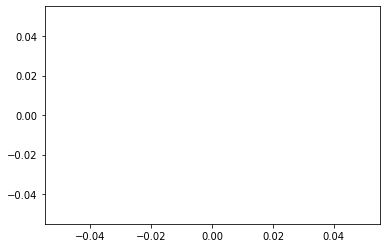

In [24]:
# learning rate of optimizer
plt.plot(lrs)

## **Testing Fuctions**

In [25]:
class test_dataset:
    """load test dataset (batchsize=1)"""
    def __init__(self, test_images, test_images_gts, testsize):
        self.testsize = testsize
        self.images = test_images
        self.gts = test_images_gts
        self.transform = transforms.Compose([
            transforms.Resize((self.testsize, self.testsize)),
            transforms.ToTensor(),
            transforms.Normalize([0.485, 0.456, 0.406], 
                                 [0.229, 0.224, 0.225])])
        self.gt_transform = transforms.ToTensor()
        self.size = len(self.images)

    def load_data(self):
        image = Image.open(self.images)
        gts = Image.open(self.gts)
        image = image.convert('RGB')
        gts = gts.convert('L')
        image = self.transform(image).unsqueeze(0)
        return image, gts

In [26]:
parser = argparse.ArgumentParser()
parser.add_argument('--testsize', type=int, default=456, help='the input size from args.lr')
parser.add_argument('--model_path', type=str,
                    default='Produced_Weights/RACOD/Kaggle/RACOD_checkpoint.pt')

testing_args = parser.parse_args("")

In [27]:
LOAD_PRETRAINED_WEIGHTS = False
#LOAD_PRETRAINED_WEIGHTS = True

# if you want to test-evaluate the model by weights produced from previous trainings
if LOAD_PRETRAINED_WEIGHTS:
    model = RACOD(
        img_size=evaluation_args.evalsize,
        embed_dims=[64, 128, 320, 512],
        num_heads=[1, 2, 5, 8],
        mlp_ratios=[4, 4, 4, 4],
        qkv_bias=True,
        norm_layer=partial(nn.LayerNorm, eps=1e-6),
        #depths=[3, 6, 40, 3],
        depths=[3, 8, 27, 3],
        sr_ratios=[8, 4, 2, 1],
        drop_rate=0.0,
        drop_path_rate=0.0,
        decoder_channels=768,
        num_classes=1
    ).cuda()

    optimizer = torch.optim.Adam(model.parameters(), testing_args.lr, weight_decay=args.lr)
    checkpoint = torch.load(testing_args.model_path)

    model.load_state_dict(checkpoint['model'])
    optimizer.load_state_dict(checkpoint['optimizer'])
    scaler.load_state_dict(checkpoint['scaler'])
    print('[INFO] Parameters Of Model Loaded From Pretrained Weights')
    model.eval()
    print('[INFO] Model Ready For Evaluation')
else:
    model.eval()
    print('[INFO] Model Ready For Evaluation')

[INFO] Model Ready For Evaluation


## **Define Evaluation Metrics**

## **Metrics From https://github.com/lartpang/PySODMetrics**

In [28]:
import numpy as np
from scipy.ndimage import convolve
from scipy.ndimage import distance_transform_edt as bwdist

_EPS = np.spacing(1)    # the different implementation of epsilon (extreme min value) between numpy and matlab
_TYPE = np.float64


def _prepare_data(pred: np.ndarray, gt: np.ndarray) -> tuple:
    """
    A numpy-based function for preparing ``pred`` and ``gt``.
    - for ``pred``, it looks like ``mapminmax(im2double(...))`` of matlab;
    - ``gt`` will be binarized by 128.
    :param pred: prediction
    :param gt: mask
    :return: pred, gt
    """
    gt = gt > 128
    # im2double, mapminmax
    pred = pred / 255
    if pred.max() != pred.min():
        pred = (pred - pred.min()) / (pred.max() - pred.min())
    return pred, gt


def _get_adaptive_threshold(matrix: np.ndarray, max_value: float = 1) -> float:
    """
    Return an adaptive threshold, which is equal to twice the mean of ``matrix``.
    :param matrix: a data array
    :param max_value: the upper limit of the threshold
    :return: min(2 * matrix.mean(), max_value)
    """
    return min(2 * matrix.mean(), max_value)


class Fmeasure(object):
    def __init__(self, beta: float = 0.3):
        """
        F-measure for SOD.
        ::
            @inproceedings{Fmeasure,
                title={Frequency-tuned salient region detection},
                author={Achanta, Radhakrishna and Hemami, Sheila and Estrada, Francisco and S{\"u}sstrunk, Sabine},
                booktitle=CVPR,
                number={CONF},
                pages={1597--1604},
                year={2009}
            }
        :param beta: the weight of the precision
        """
        self.beta = beta
        self.precisions = []
        self.recalls = []
        self.adaptive_fms = []
        self.changeable_fms = []

    def step(self, pred: np.ndarray, gt: np.ndarray):
        pred, gt = _prepare_data(pred, gt)

        adaptive_fm = self.cal_adaptive_fm(pred=pred, gt=gt)
        self.adaptive_fms.append(adaptive_fm)

        precisions, recalls, changeable_fms = self.cal_pr(pred=pred, gt=gt)
        self.precisions.append(precisions)
        self.recalls.append(recalls)
        self.changeable_fms.append(changeable_fms)

    def cal_adaptive_fm(self, pred: np.ndarray, gt: np.ndarray) -> float:
        """
        Calculate the adaptive F-measure.
        :return: adaptive_fm
        """
        # ``np.count_nonzero`` is faster and better
        adaptive_threshold = _get_adaptive_threshold(pred, max_value=1)
        binary_predcition = pred >= adaptive_threshold
        area_intersection = binary_predcition[gt].sum()
        if area_intersection == 0:
            adaptive_fm = 0
        else:
            pre = area_intersection / np.count_nonzero(binary_predcition)
            rec = area_intersection / np.count_nonzero(gt)
            adaptive_fm = (1 + self.beta) * pre * rec / (self.beta * pre + rec)
        return adaptive_fm

    def cal_pr(self, pred: np.ndarray, gt: np.ndarray) -> tuple:
        """
        Calculate the corresponding precision and recall when the threshold changes from 0 to 255.
        These precisions and recalls can be used to obtain the mean F-measure, maximum F-measure,
        precision-recall curve and F-measure-threshold curve.
        For convenience, ``changeable_fms`` is provided here, which can be used directly to obtain
        the mean F-measure, maximum F-measure and F-measure-threshold curve.
        :return: precisions, recalls, changeable_fms
        """
        # 1. 获取预测结果在真值前背景区域中的直方图
        pred = (pred * 255).astype(np.uint8)
        bins = np.linspace(0, 256, 257)
        fg_hist, _ = np.histogram(pred[gt], bins=bins)  # 最后一个bin为[255, 256]
        bg_hist, _ = np.histogram(pred[~gt], bins=bins)
        # 2. 使用累积直方图（Cumulative Histogram）获得对应真值前背景中大于不同阈值的像素数量
        # 这里使用累加（cumsum）就是为了一次性得出 >=不同阈值 的像素数量, 这里仅计算了前景区域
        fg_w_thrs = np.cumsum(np.flip(fg_hist), axis=0)
        bg_w_thrs = np.cumsum(np.flip(bg_hist), axis=0)
        # 3. 使用不同阈值的结果计算对应的precision和recall
        # p和r的计算的真值是pred==1&gt==1，二者仅有分母不同，分母前者是pred==1，后者是gt==1
        # 为了同时计算不同阈值的结果，这里使用hsitogram&flip&cumsum 获得了不同各自的前景像素数量
        TPs = fg_w_thrs
        Ps = fg_w_thrs + bg_w_thrs
        # 为防止除0，这里针对除0的情况分析后直接对于0分母设为1，因为此时分子必为0
        Ps[Ps == 0] = 1
        T = max(np.count_nonzero(gt), 1)
        # TODO: T=0 或者 特定阈值下fg_w_thrs=0或者bg_w_thrs=0，这些都会包含在TPs[i]=0的情况中，
        #  但是这里使用TPs不便于处理列表
        precisions = TPs / Ps
        recalls = TPs / T

        numerator = (1 + self.beta) * precisions * recalls
        denominator = np.where(numerator == 0, 1, self.beta * precisions + recalls)
        changeable_fms = numerator / denominator
        return precisions, recalls, changeable_fms

    def get_results(self) -> dict:
        """
        Return the results about F-measure.
        :return: dict(fm=dict(adp=adaptive_fm, curve=changeable_fm), pr=dict(p=precision, r=recall))
        """
        adaptive_fm = np.mean(np.array(self.adaptive_fms, _TYPE))
        changeable_fm = np.mean(np.array(self.changeable_fms, dtype=_TYPE), axis=0)
        precision = np.mean(np.array(self.precisions, dtype=_TYPE), axis=0)  # N, 256
        recall = np.mean(np.array(self.recalls, dtype=_TYPE), axis=0)  # N, 256
        return dict(fm=dict(adp=adaptive_fm, curve=changeable_fm), pr=dict(p=precision, r=recall))


class MAE(object):
    def __init__(self):
        """
        MAE(mean absolute error) for SOD.
        ::
            @inproceedings{MAE,
                title={Saliency filters: Contrast based filtering for salient region detection},
                author={Perazzi, Federico and Kr{\"a}henb{\"u}hl, Philipp and Pritch, Yael and Hornung, Alexander},
                booktitle=CVPR,
                pages={733--740},
                year={2012}
            }
        """
        self.maes = []

    def step(self, pred: np.ndarray, gt: np.ndarray):
        pred, gt = _prepare_data(pred, gt)

        mae = self.cal_mae(pred, gt)
        self.maes.append(mae)

    def cal_mae(self, pred: np.ndarray, gt: np.ndarray) -> np.ndarray:
        """
        Calculate the mean absolute error.
        :return: mae
        """
        mae = np.mean(np.abs(pred - gt))
        return mae

    def get_results(self) -> dict:
        """
        Return the results about MAE.
        :return: dict(mae=mae)
        """
        mae = np.mean(np.array(self.maes, _TYPE))
        return dict(mae=mae)


class Smeasure(object):
    def __init__(self, alpha: float = 0.5):
        """
        S-measure(Structure-measure) of SOD.
        ::
            @inproceedings{Smeasure,
                title={Structure-measure: A new way to eval foreground maps},
                author={Fan, Deng-Ping and Cheng, Ming-Ming and Liu, Yun and Li, Tao and Borji, Ali},
                booktitle=ICCV,
                pages={4548--4557},
                year={2017}
            }
        :param alpha: the weight for balancing the object score and the region score
        """
        self.sms = []
        self.alpha = alpha

    def step(self, pred: np.ndarray, gt: np.ndarray):
        pred, gt = _prepare_data(pred=pred, gt=gt)

        sm = self.cal_sm(pred, gt)
        self.sms.append(sm)

    def cal_sm(self, pred: np.ndarray, gt: np.ndarray) -> float:
        """
        Calculate the S-measure.
        :return: s-measure
        """
        y = np.mean(gt)
        if y == 0:
            sm = 1 - np.mean(pred)
        elif y == 1:
            sm = np.mean(pred)
        else:
            sm = self.alpha * self.object(pred, gt) + (1 - self.alpha) * self.region(pred, gt)
            sm = max(0, sm)
        return sm

    def object(self, pred: np.ndarray, gt: np.ndarray) -> float:
        """
        Calculate the object score.
        """
        fg = pred * gt
        bg = (1 - pred) * (1 - gt)
        u = np.mean(gt)
        object_score = u * self.s_object(fg, gt) + (1 - u) * self.s_object(bg, 1 - gt)
        return object_score

    def s_object(self, pred: np.ndarray, gt: np.ndarray) -> float:
        x = np.mean(pred[gt == 1])
        sigma_x = np.std(pred[gt == 1], ddof=1)
        score = 2 * x / (np.power(x, 2) + 1 + sigma_x + _EPS)
        return score

    def region(self, pred: np.ndarray, gt: np.ndarray) -> float:
        """
        Calculate the region score.
        """
        x, y = self.centroid(gt)
        part_info = self.divide_with_xy(pred, gt, x, y)
        w1, w2, w3, w4 = part_info["weight"]
        # assert np.isclose(w1 + w2 + w3 + w4, 1), (w1 + w2 + w3 + w4, pred.mean(), gt.mean())

        pred1, pred2, pred3, pred4 = part_info["pred"]
        gt1, gt2, gt3, gt4 = part_info["gt"]
        score1 = self.ssim(pred1, gt1)
        score2 = self.ssim(pred2, gt2)
        score3 = self.ssim(pred3, gt3)
        score4 = self.ssim(pred4, gt4)

        return w1 * score1 + w2 * score2 + w3 * score3 + w4 * score4

    def centroid(self, matrix: np.ndarray) -> tuple:
        """
        To ensure consistency with the matlab code, one is added to the centroid coordinate,
        so there is no need to use the redundant addition operation when dividing the region later,
        because the sequence generated by ``1:X`` in matlab will contain ``X``.
        :param matrix: a bool data array
        :return: the centroid coordinate
        """
        h, w = matrix.shape
        area_object = np.count_nonzero(matrix)
        if area_object == 0:
            x = np.round(w / 2)
            y = np.round(h / 2)
        else:
            # More details can be found at: https://www.yuque.com/lart/blog/gpbigm
            y, x = np.argwhere(matrix).mean(axis=0).round()
        return int(x) + 1, int(y) + 1

    def divide_with_xy(self, pred: np.ndarray, gt: np.ndarray, x: int, y: int) -> dict:
        """
        Use (x,y) to divide the ``pred`` and the ``gt`` into four submatrices, respectively.
        """
        h, w = gt.shape
        area = h * w

        gt_LT = gt[0:y, 0:x]
        gt_RT = gt[0:y, x:w]
        gt_LB = gt[y:h, 0:x]
        gt_RB = gt[y:h, x:w]

        pred_LT = pred[0:y, 0:x]
        pred_RT = pred[0:y, x:w]
        pred_LB = pred[y:h, 0:x]
        pred_RB = pred[y:h, x:w]

        w1 = x * y / area
        w2 = y * (w - x) / area
        w3 = (h - y) * x / area
        w4 = 1 - w1 - w2 - w3

        return dict(
            gt=(gt_LT, gt_RT, gt_LB, gt_RB),
            pred=(pred_LT, pred_RT, pred_LB, pred_RB),
            weight=(w1, w2, w3, w4),
        )

    def ssim(self, pred: np.ndarray, gt: np.ndarray) -> float:
        """
        Calculate the ssim score.
        """
        h, w = pred.shape
        N = h * w

        x = np.mean(pred)
        y = np.mean(gt)

        sigma_x = np.sum((pred - x) ** 2) / (N - 1)
        sigma_y = np.sum((gt - y) ** 2) / (N - 1)
        sigma_xy = np.sum((pred - x) * (gt - y)) / (N - 1)

        alpha = 4 * x * y * sigma_xy
        beta = (x ** 2 + y ** 2) * (sigma_x + sigma_y)

        if alpha != 0:
            score = alpha / (beta + _EPS)
        elif alpha == 0 and beta == 0:
            score = 1
        else:
            score = 0
        return score

    def get_results(self) -> dict:
        """
        Return the results about S-measure.
        :return: dict(sm=sm)
        """
        sm = np.mean(np.array(self.sms, dtype=_TYPE))
        return dict(sm=sm)


class Emeasure(object):
    def __init__(self):
        """
        E-measure(Enhanced-alignment Measure) for SOD.
        More details about the implementation can be found in https://www.yuque.com/lart/blog/lwgt38
        ::
            @inproceedings{Emeasure,
                title="Enhanced-alignment Measure for Binary Foreground Map Evaluation",
                author="Deng-Ping {Fan} and Cheng {Gong} and Yang {Cao} and Bo {Ren} and Ming-Ming {Cheng} and Ali {Borji}",
                booktitle=IJCAI,
                pages="698--704",
                year={2018}
            }
        """
        self.adaptive_ems = []
        self.changeable_ems = []

    def step(self, pred: np.ndarray, gt: np.ndarray):
        pred, gt = _prepare_data(pred=pred, gt=gt)
        self.gt_fg_numel = np.count_nonzero(gt)
        self.gt_size = gt.shape[0] * gt.shape[1]

        changeable_ems = self.cal_changeable_em(pred, gt)
        self.changeable_ems.append(changeable_ems)
        adaptive_em = self.cal_adaptive_em(pred, gt)
        self.adaptive_ems.append(adaptive_em)

    def cal_adaptive_em(self, pred: np.ndarray, gt: np.ndarray) -> float:
        """
        Calculate the adaptive E-measure.
        :return: adaptive_em
        """
        adaptive_threshold = _get_adaptive_threshold(pred, max_value=1)
        adaptive_em = self.cal_em_with_threshold(pred, gt, threshold=adaptive_threshold)
        return adaptive_em

    def cal_changeable_em(self, pred: np.ndarray, gt: np.ndarray) -> np.ndarray:
        """
        Calculate the changeable E-measure, which can be used to obtain the mean E-measure,
        the maximum E-measure and the E-measure-threshold curve.
        :return: changeable_ems
        """
        changeable_ems = self.cal_em_with_cumsumhistogram(pred, gt)
        return changeable_ems

    def cal_em_with_threshold(self, pred: np.ndarray, gt: np.ndarray, threshold: float) -> float:
        """
        Calculate the E-measure corresponding to the specific threshold.
        Variable naming rules within the function:
        ``[pred attribute(foreground fg, background bg)]_[gt attribute(foreground fg, background bg)]_[meaning]``
        If only ``pred`` or ``gt`` is considered, another corresponding attribute location is replaced with '``_``'.
        """
        binarized_pred = pred >= threshold
        fg_fg_numel = np.count_nonzero(binarized_pred & gt)
        fg_bg_numel = np.count_nonzero(binarized_pred & ~gt)

        fg___numel = fg_fg_numel + fg_bg_numel
        bg___numel = self.gt_size - fg___numel

        if self.gt_fg_numel == 0:
            enhanced_matrix_sum = bg___numel
        elif self.gt_fg_numel == self.gt_size:
            enhanced_matrix_sum = fg___numel
        else:
            parts_numel, combinations = self.generate_parts_numel_combinations(
                fg_fg_numel=fg_fg_numel,
                fg_bg_numel=fg_bg_numel,
                pred_fg_numel=fg___numel,
                pred_bg_numel=bg___numel,
            )

            results_parts = []
            for i, (part_numel, combination) in enumerate(zip(parts_numel, combinations)):
                align_matrix_value = (
                    2
                    * (combination[0] * combination[1])
                    / (combination[0] ** 2 + combination[1] ** 2 + _EPS)
                )
                enhanced_matrix_value = (align_matrix_value + 1) ** 2 / 4
                results_parts.append(enhanced_matrix_value * part_numel)
            enhanced_matrix_sum = sum(results_parts)

        em = enhanced_matrix_sum / (self.gt_size - 1 + _EPS)
        return em

    def cal_em_with_cumsumhistogram(self, pred: np.ndarray, gt: np.ndarray) -> np.ndarray:
        """
        Calculate the E-measure corresponding to the threshold that varies from 0 to 255..
        Variable naming rules within the function:
        ``[pred attribute(foreground fg, background bg)]_[gt attribute(foreground fg, background bg)]_[meaning]``
        If only ``pred`` or ``gt`` is considered, another corresponding attribute location is replaced with '``_``'.
        """
        pred = (pred * 255).astype(np.uint8)
        bins = np.linspace(0, 256, 257)
        fg_fg_hist, _ = np.histogram(pred[gt], bins=bins)
        fg_bg_hist, _ = np.histogram(pred[~gt], bins=bins)
        fg_fg_numel_w_thrs = np.cumsum(np.flip(fg_fg_hist), axis=0)
        fg_bg_numel_w_thrs = np.cumsum(np.flip(fg_bg_hist), axis=0)

        fg___numel_w_thrs = fg_fg_numel_w_thrs + fg_bg_numel_w_thrs
        bg___numel_w_thrs = self.gt_size - fg___numel_w_thrs

        if self.gt_fg_numel == 0:
            enhanced_matrix_sum = bg___numel_w_thrs
        elif self.gt_fg_numel == self.gt_size:
            enhanced_matrix_sum = fg___numel_w_thrs
        else:
            parts_numel_w_thrs, combinations = self.generate_parts_numel_combinations(
                fg_fg_numel=fg_fg_numel_w_thrs,
                fg_bg_numel=fg_bg_numel_w_thrs,
                pred_fg_numel=fg___numel_w_thrs,
                pred_bg_numel=bg___numel_w_thrs,
            )

            results_parts = np.empty(shape=(4, 256), dtype=np.float64)
            for i, (part_numel, combination) in enumerate(zip(parts_numel_w_thrs, combinations)):
                align_matrix_value = (
                    2
                    * (combination[0] * combination[1])
                    / (combination[0] ** 2 + combination[1] ** 2 + _EPS)
                )
                enhanced_matrix_value = (align_matrix_value + 1) ** 2 / 4
                results_parts[i] = enhanced_matrix_value * part_numel
            enhanced_matrix_sum = results_parts.sum(axis=0)

        em = enhanced_matrix_sum / (self.gt_size - 1 + _EPS)
        return em

    def generate_parts_numel_combinations(
        self, fg_fg_numel, fg_bg_numel, pred_fg_numel, pred_bg_numel
    ):
        bg_fg_numel = self.gt_fg_numel - fg_fg_numel
        bg_bg_numel = pred_bg_numel - bg_fg_numel

        parts_numel = [fg_fg_numel, fg_bg_numel, bg_fg_numel, bg_bg_numel]

        mean_pred_value = pred_fg_numel / self.gt_size
        mean_gt_value = self.gt_fg_numel / self.gt_size

        demeaned_pred_fg_value = 1 - mean_pred_value
        demeaned_pred_bg_value = 0 - mean_pred_value
        demeaned_gt_fg_value = 1 - mean_gt_value
        demeaned_gt_bg_value = 0 - mean_gt_value

        combinations = [
            (demeaned_pred_fg_value, demeaned_gt_fg_value),
            (demeaned_pred_fg_value, demeaned_gt_bg_value),
            (demeaned_pred_bg_value, demeaned_gt_fg_value),
            (demeaned_pred_bg_value, demeaned_gt_bg_value),
        ]
        return parts_numel, combinations

    def get_results(self) -> dict:
        """
        Return the results about E-measure.
        :return: dict(em=dict(adp=adaptive_em, curve=changeable_em))
        """
        adaptive_em = np.mean(np.array(self.adaptive_ems, dtype=_TYPE))
        changeable_em = np.mean(np.array(self.changeable_ems, dtype=_TYPE), axis=0)
        return dict(em=dict(adp=adaptive_em, curve=changeable_em))


class WeightedFmeasure(object):
    def __init__(self, beta: float = 1):
        """
        Weighted F-measure for SOD.
        ::
            @inproceedings{wFmeasure,
                title={How to eval foreground maps?},
                author={Margolin, Ran and Zelnik-Manor, Lihi and Tal, Ayellet},
                booktitle=CVPR,
                pages={248--255},
                year={2014}
            }
        :param beta: the weight of the precision
        """
        self.beta = beta
        self.weighted_fms = []

    def step(self, pred: np.ndarray, gt: np.ndarray):
        pred, gt = _prepare_data(pred=pred, gt=gt)

        if np.all(~gt):
            wfm = 0
        else:
            wfm = self.cal_wfm(pred, gt)
        self.weighted_fms.append(wfm)

    def cal_wfm(self, pred: np.ndarray, gt: np.ndarray) -> float:
        """
        Calculate the weighted F-measure.
        """
        # [Dst,IDXT] = bwdist(dGT);
        Dst, Idxt = bwdist(gt == 0, return_indices=True)

        # %Pixel dependency
        # E = abs(FG-dGT);
        E = np.abs(pred - gt)
        # Et = E;
        # Et(~GT)=Et(IDXT(~GT)); %To deal correctly with the edges of the foreground region
        Et = np.copy(E)
        Et[gt == 0] = Et[Idxt[0][gt == 0], Idxt[1][gt == 0]]

        # K = fspecial('gaussian',7,5);
        # EA = imfilter(Et,K);
        K = self.matlab_style_gauss2D((7, 7), sigma=5)
        EA = convolve(Et, weights=K, mode="constant", cval=0)
        # MIN_E_EA = E;
        # MIN_E_EA(GT & EA<E) = EA(GT & EA<E);
        MIN_E_EA = np.where(gt & (EA < E), EA, E)

        # %Pixel importance
        # B = ones(size(GT));
        # B(~GT) = 2-1*exp(log(1-0.5)/5.*Dst(~GT));
        # Ew = MIN_E_EA.*B;
        B = np.where(gt == 0, 2 - np.exp(np.log(0.5) / 5 * Dst), np.ones_like(gt))
        Ew = MIN_E_EA * B

        # TPw = sum(dGT(:)) - sum(sum(Ew(GT)));
        # FPw = sum(sum(Ew(~GT)));
        TPw = np.sum(gt) - np.sum(Ew[gt == 1])
        FPw = np.sum(Ew[gt == 0])

        # R = 1- mean2(Ew(GT)); %Weighed Recall
        # P = TPw./(eps+TPw+FPw); %Weighted Precision
        # 注意这里使用mask索引矩阵的时候不可使用Ew[gt]，这实际上仅在索引Ew的0维度
        R = 1 - np.mean(Ew[gt == 1])
        P = TPw / (TPw + FPw + _EPS)

        # % Q = (1+Beta^2)*(R*P)./(eps+R+(Beta.*P));
        Q = (1 + self.beta) * R * P / (R + self.beta * P + _EPS)

        return Q

    def matlab_style_gauss2D(self, shape: tuple = (7, 7), sigma: int = 5) -> np.ndarray:
        """
        2D gaussian mask - should give the same result as MATLAB's
        fspecial('gaussian',[shape],[sigma])
        """
        m, n = [(ss - 1) / 2 for ss in shape]
        y, x = np.ogrid[-m : m + 1, -n : n + 1]
        h = np.exp(-(x * x + y * y) / (2 * sigma * sigma))
        h[h < np.finfo(h.dtype).eps * h.max()] = 0
        sumh = h.sum()
        if sumh != 0:
            h /= sumh
        return h

    def get_results(self) -> dict:
        """
        Return the results about weighted F-measure.
        :return: dict(wfm=weighted_fm)
        """
        weighted_fm = np.mean(np.array(self.weighted_fms, dtype=_TYPE))
        return dict(wfm=weighted_fm)

In [29]:
dictionary_of_evaluation = {}
dictionary_of_evaluation['chameleon_evaluate_test_images'] = test_images_chameleon
dictionary_of_evaluation['chameleon_evaluate_gt_object_images'] = test_images_chameleon_gt_object
dictionary_of_evaluation['camo_evaluate_test_images'] = test_images_camo
dictionary_of_evaluation['camo_evaluate_gt_object_images'] = test_images_camo_gt_object
dictionary_of_evaluation['cod10k_evaluate_test_images'] = test_images_cod10k
dictionary_of_evaluation['cod10k_evaluate_gt_object_images'] = test_images_cod10k_gt_object
dictionary_of_evaluation['nc4k_evaluate_test_images'] = test_images_nc4k
dictionary_of_evaluation['nc4k_evaluate_gt_object_images'] = test_images_nc4k_gt_object

In [30]:
for i in tqdm(range(0, len(dictionary_of_evaluation), 2)):
    dataset = list(dictionary_of_evaluation.items())[i:i+2]
    num_holder = len(dataset[0][0]) - len('evaluate_test_images')
    dataset_name = dataset[0][0][:num_holder - 1].upper()
    # define functions
    WFM = WeightedFmeasure()
    SM = Smeasure()
    EM = Emeasure()
    _MAE = MAE()

    for i in tqdm(range(len(dataset[0][1]))):
        test_loader = test_dataset(dataset[0][1][i], dataset[1][1][i], testsize=testing_args.testsize)
        image, gt = test_loader.load_data()
        gt = np.asarray(gt, np.float32)
        image = image.cuda()
        # inference
        _, output_mask = model(image)
        # reshape and normalize
        output_mask = F.interpolate(output_mask, size=gt.shape, mode='bilinear', align_corners=False)
        output_mask = torch.sigmoid(output_mask)
        output_mask = np.uint8(output_mask.squeeze().detach().cpu().numpy()*255)
        output_mask = output_mask / np.linalg.norm(output_mask)
        # metrics
        WFM.step(pred=output_mask, gt=gt)
        SM.step(pred=output_mask, gt=gt)
        EM.step(pred=output_mask, gt=gt)
        _MAE.step(pred=output_mask, gt=gt)
        
    wfm = WFM.get_results()['wfm']
    sm = SM.get_results()['sm']
    em = EM.get_results()['em']
    mae = _MAE.get_results()['mae']
    e_measure_adp = em['adp'].mean()
    e_measure_mean = em['curve'].mean()
    
    print(f'[Testing Done In {dataset_name} Dataset] Mean Absolute Error => {mae:.3f}')
    print(f'[Testing Done In {dataset_name} Dataset] Weighted F-measure => {wfm:.3f}')
    print(f'[Testing Done In {dataset_name} Dataset] S-measure => {sm:.3f}')
    print(f'[Testing Done In {dataset_name} Dataset] E-measure Adp => {e_measure_adp:.3f}')
    print(f'[Testing Done In {dataset_name} Dataset] E-measure Mean => {e_measure_mean:.3f}')
    print(65*'*')

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/76 [00:00<?, ?it/s]

[Testing Done In CHAMELEON Dataset] Mean Absolute Error => 0.022
[Testing Done In CHAMELEON Dataset] Weighted F-measure => 0.876
[Testing Done In CHAMELEON Dataset] S-measure => 0.909
[Testing Done In CHAMELEON Dataset] E-measure Adp => 0.966
[Testing Done In CHAMELEON Dataset] E-measure Mean => 0.951
*****************************************************************


  0%|          | 0/250 [00:00<?, ?it/s]

[Testing Done In CAMO Dataset] Mean Absolute Error => 0.049
[Testing Done In CAMO Dataset] Weighted F-measure => 0.827
[Testing Done In CAMO Dataset] S-measure => 0.862
[Testing Done In CAMO Dataset] E-measure Adp => 0.920
[Testing Done In CAMO Dataset] E-measure Mean => 0.919
*****************************************************************


  0%|          | 0/2026 [00:00<?, ?it/s]

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:22: RuntimeWarning: invalid value encountered in true_divide


[Testing Done In COD10K Dataset] Mean Absolute Error => nan
[Testing Done In COD10K Dataset] Weighted F-measure => nan
[Testing Done In COD10K Dataset] S-measure => 0.868
[Testing Done In COD10K Dataset] E-measure Adp => 0.943
[Testing Done In COD10K Dataset] E-measure Mean => 0.935
*****************************************************************


  0%|          | 0/4121 [00:00<?, ?it/s]

[Testing Done In NC4K Dataset] Mean Absolute Error => 0.033
[Testing Done In NC4K Dataset] Weighted F-measure => 0.848
[Testing Done In NC4K Dataset] S-measure => 0.884
[Testing Done In NC4K Dataset] E-measure Adp => 0.937
[Testing Done In NC4K Dataset] E-measure Mean => 0.934
*****************************************************************


## **Test: Showing Some Random Results Of Our Model Over TestSet**

In [31]:
import random

random_index_list = set()
while len(random_index_list) < 200:
    j = random.randint(0, len(test_images) - 1)
    random_index_list.add(j)
print(f'Created {len(random_index_list)} random indexes for our testing')

Created 200 random indexes for our testing


In [32]:
random_index_list = sorted(list(random_index_list))

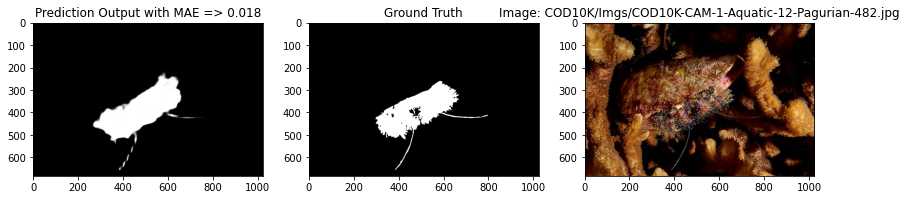

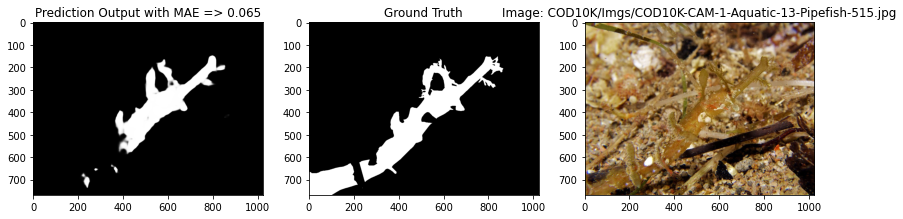

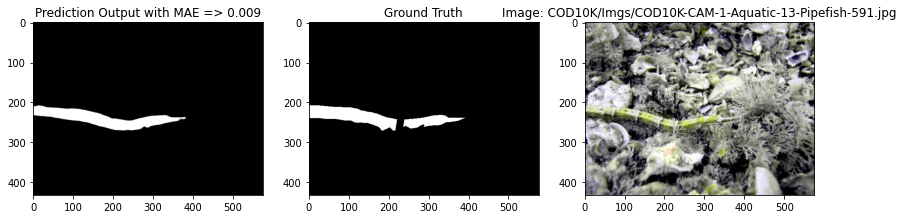

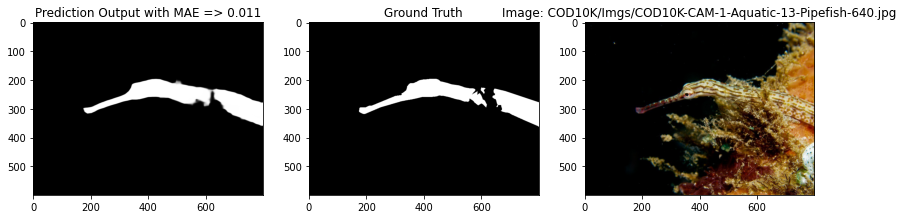

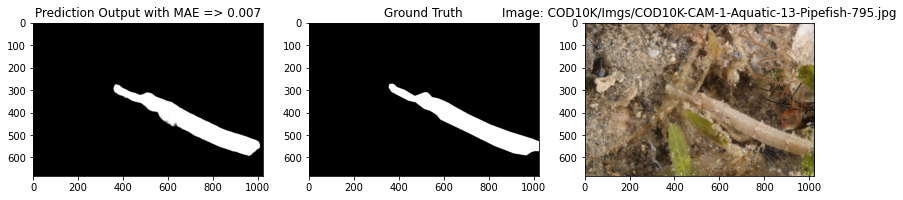

...

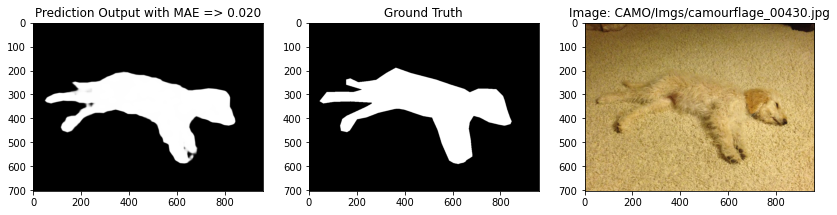

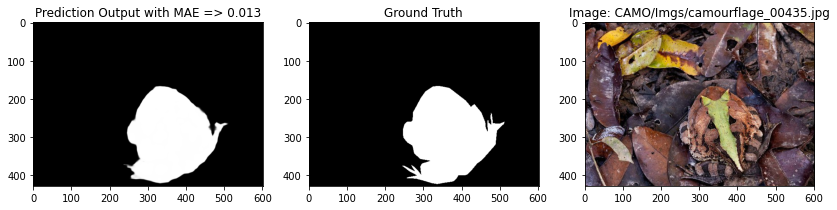

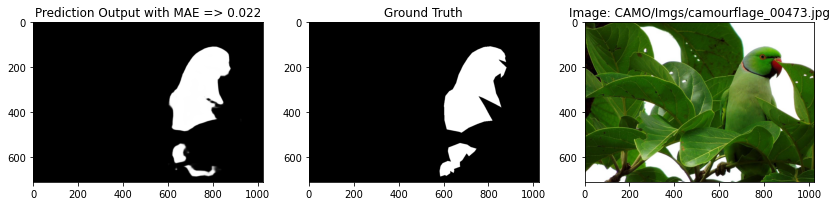

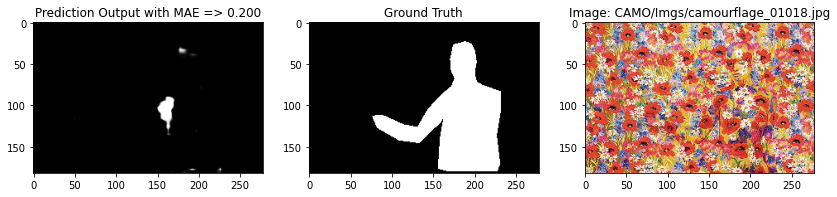

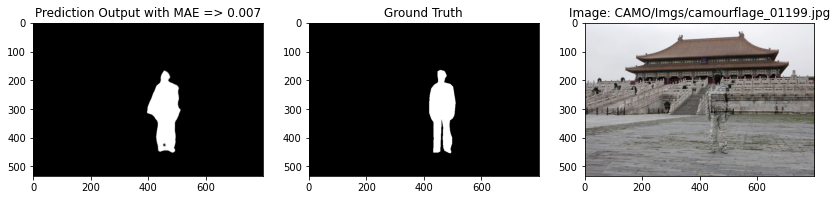

In [33]:
import random
plt.rcParams.update({'figure.max_open_warning': 0})

for j in range(len(random_index_list)):
    _MAE = MAE()
    test_loader = test_dataset(test_images[random_index_list[j]], test_images_gt_object[random_index_list[j]], testsize=testing_args.testsize)
    image, gt = test_loader.load_data()
    gt = np.asarray(gt, np.float32)
    #print(gt)
    image = image.cuda()
    # inference
    _, output_mask = model(image)
    # reshape and normalize
    output_mask = F.interpolate(output_mask, size=gt.shape, mode='bilinear', align_corners=False)
    output_mask = torch.sigmoid(output_mask)
    output_mask = np.uint8(output_mask.squeeze().detach().cpu().numpy()*255)
    output_mask = output_mask / np.linalg.norm(output_mask)
    _MAE.step(pred=output_mask, gt=gt)
    temp = _MAE.get_results()['mae']
    _, ax_main = plt.subplots(1, 3, figsize = (14, 8))
    ax_main[0].title.set_text(f"Prediction Output with MAE => {temp:.3f}")
    ax_main[0].imshow(output_mask, cmap='gist_gray')
    ax_main[1].title.set_text(f"Ground Truth")
    ax_main[1].imshow(gt, cmap='gist_gray')
    ax_main[2].title.set_text(f"Image: {test_images[random_index_list[j]][38:]}")
    ax_main[2].imshow(Image.open(test_images[random_index_list[j]]))